# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [2]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [3]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [4]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [5]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [6]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [7]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [8]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [10]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm - 1)**2)
    #### END CODE HERE ####
    return penalty

In [11]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [14]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -torch.mean(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [15]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [22]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss =  torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda*gp
    #### END CODE HERE ####
    return crit_loss

In [23]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.07692785705439746, critic loss: 1.8876295580267908


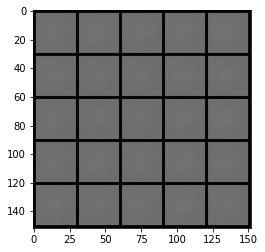

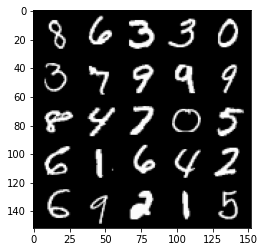

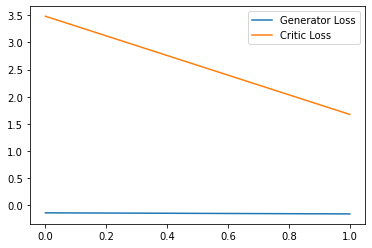

Step 100: Generator loss: 1.066976991891861, critic loss: -2.192562531352044


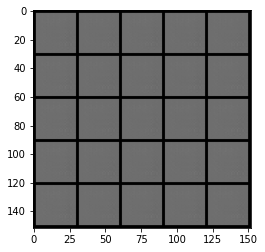

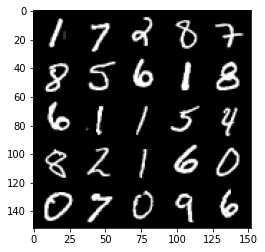

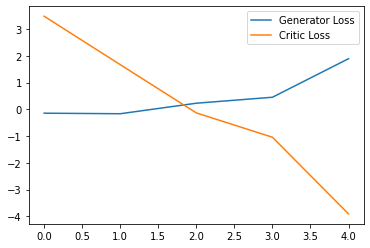

Step 150: Generator loss: 2.7462743496894837, critic loss: -11.929084821701046


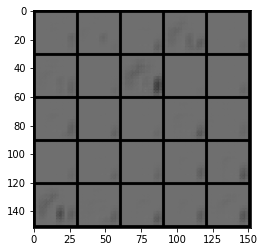

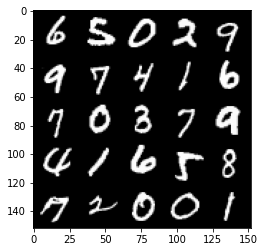

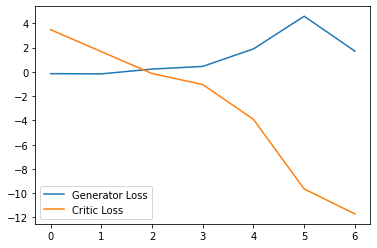

Step 200: Generator loss: -0.06423449411988258, critic loss: -27.142356094360355


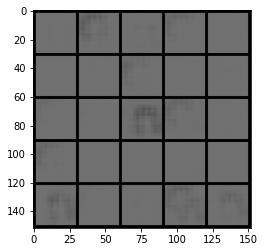

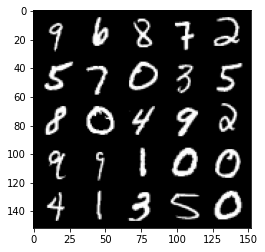

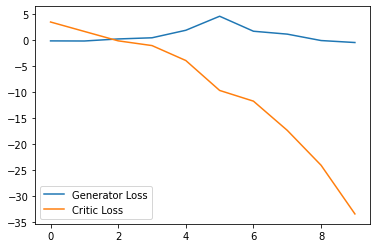

Step 250: Generator loss: -0.5501442165672779, critic loss: -54.54123233032225


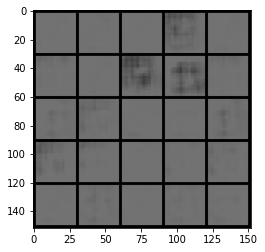

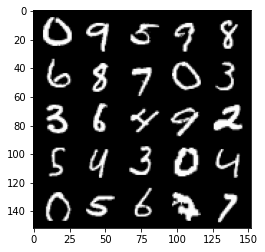

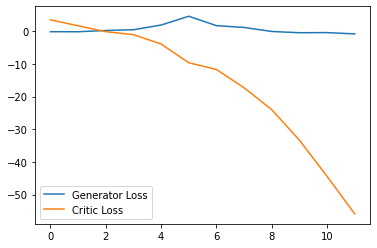

Step 300: Generator loss: 0.18258726082742213, critic loss: -91.61498243713376


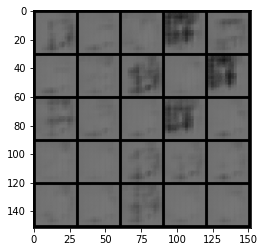

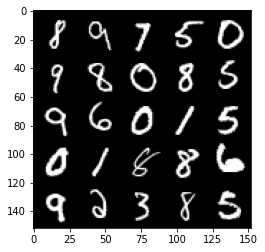

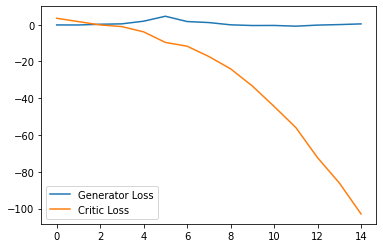

Step 350: Generator loss: 3.159765567779541, critic loss: -134.60342132568363


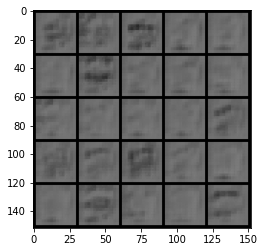

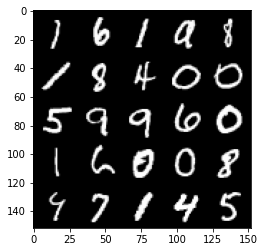

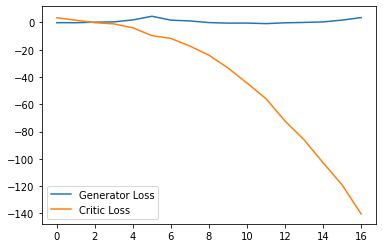

Step 400: Generator loss: 7.49278389453888, critic loss: -182.99967794799807


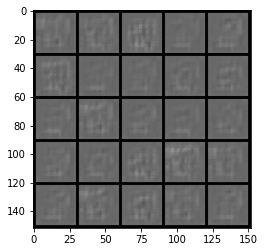

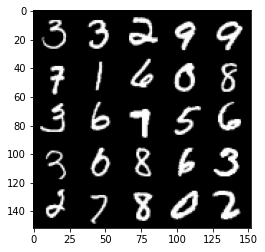

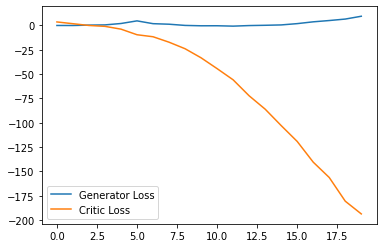

Step 450: Generator loss: 14.473116054534913, critic loss: -235.43546228027338


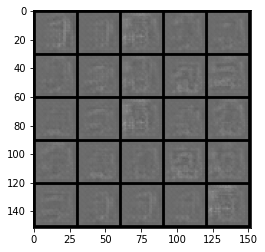

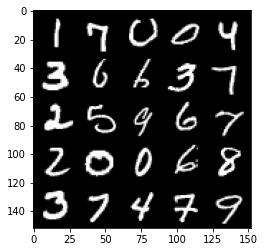

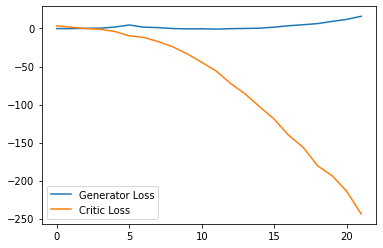

Step 500: Generator loss: 19.62585884094238, critic loss: -287.6853635864258


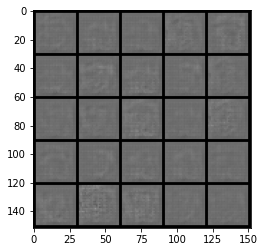

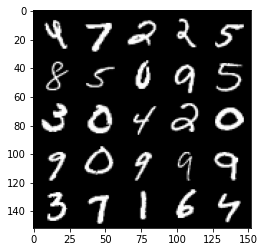

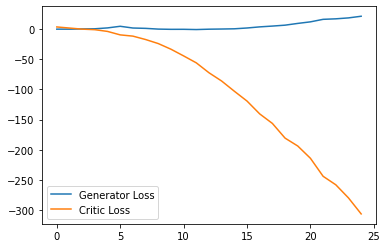

Step 550: Generator loss: 24.099785690307616, critic loss: -345.3397941894531


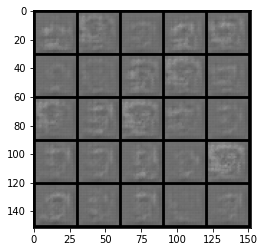

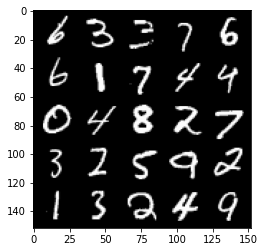

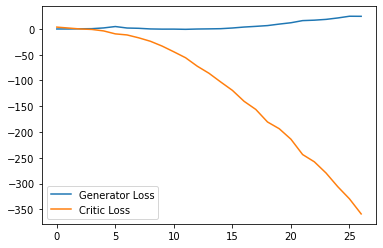

Step 600: Generator loss: 22.161990694999695, critic loss: -384.0506976623535


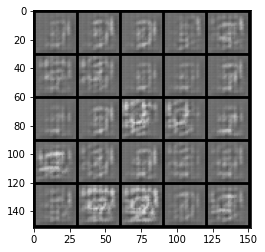

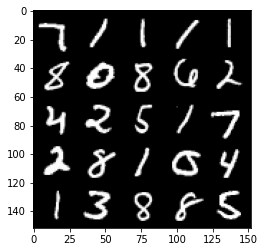

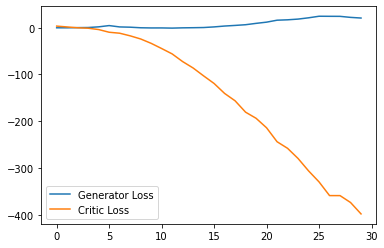

Step 650: Generator loss: -1.4580207896232604, critic loss: -364.0977161560059


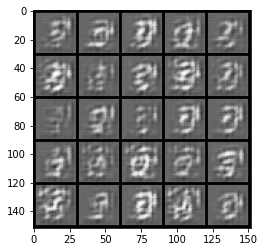

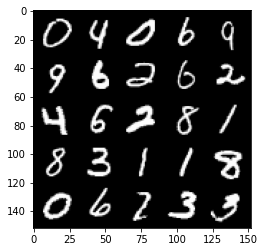

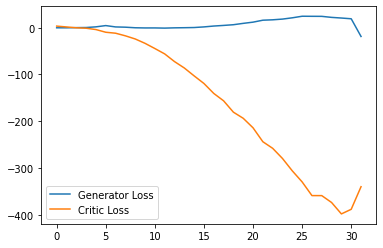

Step 700: Generator loss: -26.90569716453552, critic loss: -301.3857831726073


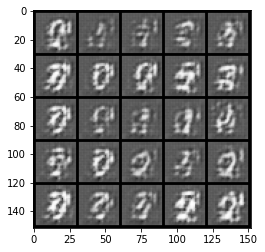

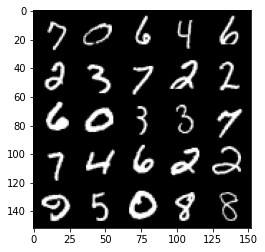

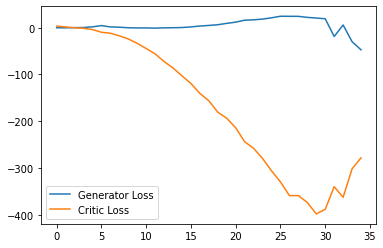

Step 750: Generator loss: -10.864372398257256, critic loss: -248.94940112304687


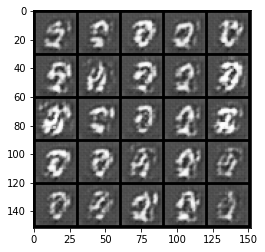

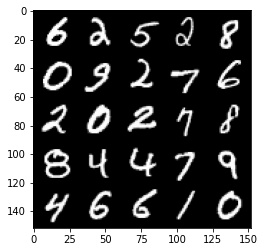

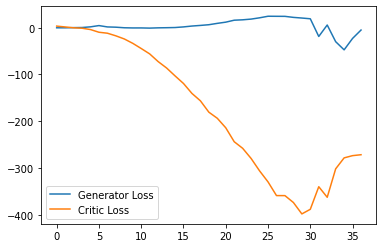

Step 800: Generator loss: -31.808434175252913, critic loss: -149.76992774963378


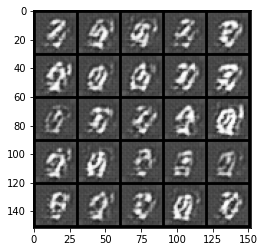

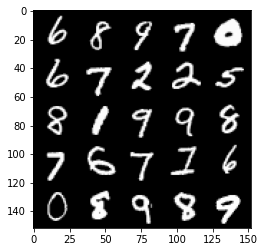

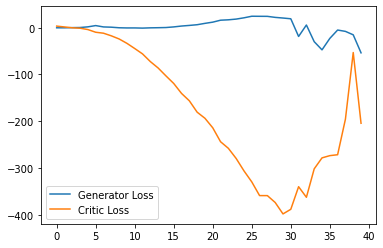

Step 850: Generator loss: -75.93272832870484, critic loss: -187.73468151855468


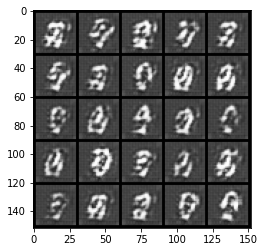

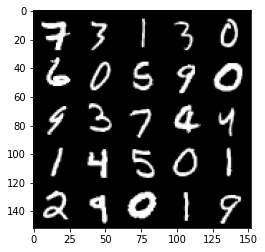

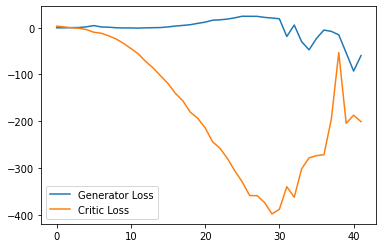

Step 900: Generator loss: -56.15209839701652, critic loss: -160.6921932220459


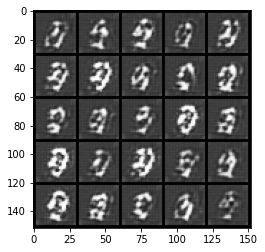

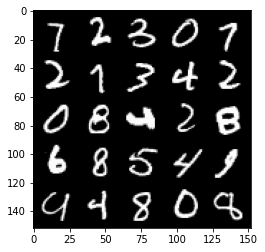

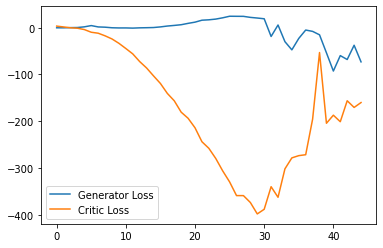

Step 950: Generator loss: -32.151675819158555, critic loss: -157.9018290252685


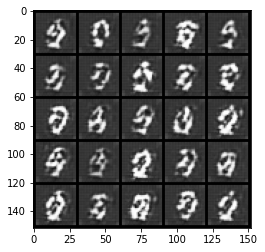

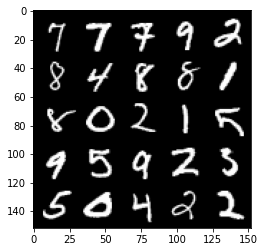

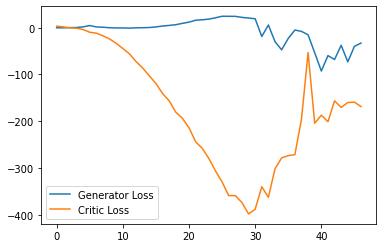

Step 1000: Generator loss: 3.081005187034607, critic loss: -67.44639179992679


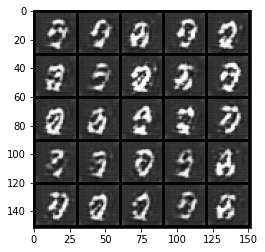

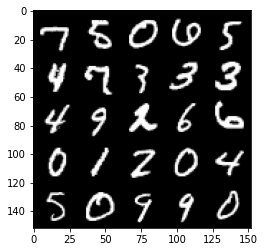

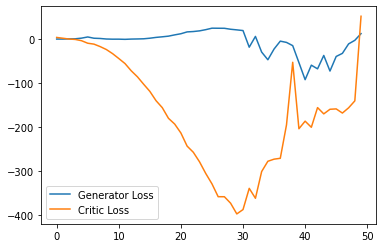

Step 1050: Generator loss: 11.87821409225464, critic loss: 15.105113536834713


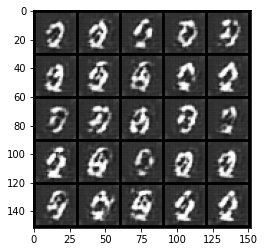

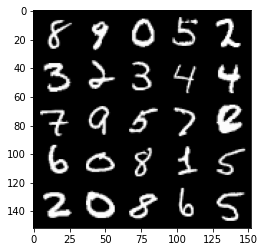

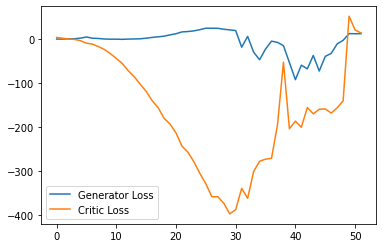

Step 1100: Generator loss: 8.920340328216552, critic loss: 5.6400860862731905


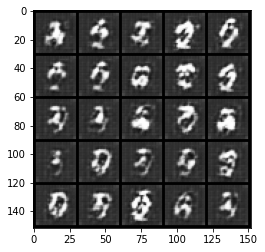

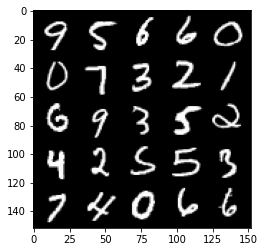

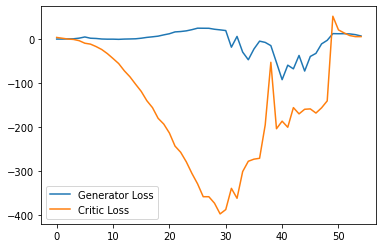

Step 1150: Generator loss: 5.4306256341934205, critic loss: 13.049711151123047


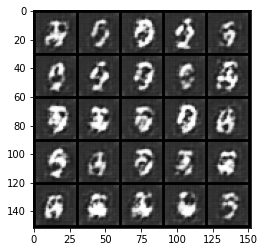

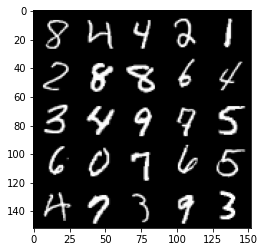

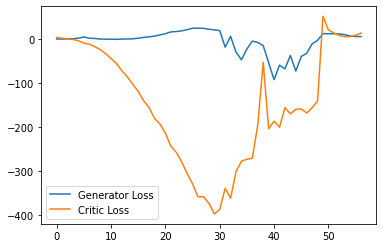

Step 1200: Generator loss: 5.211794080734253, critic loss: 22.231646408081048


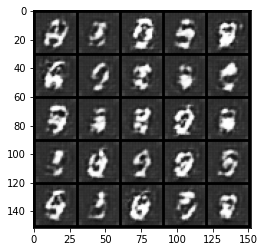

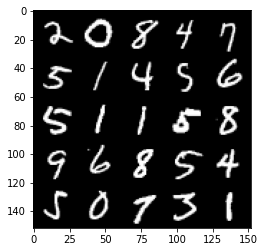

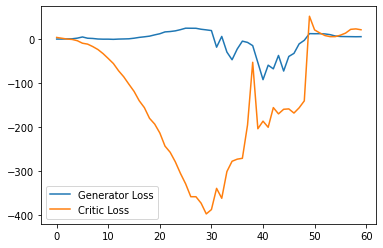

Step 1250: Generator loss: 5.764651217460632, critic loss: 12.793331512451168


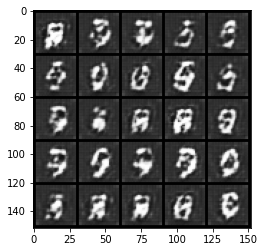

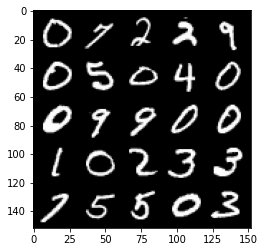

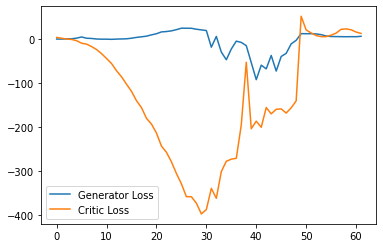

Step 1300: Generator loss: 6.966512480378151, critic loss: 1.5883373260498044


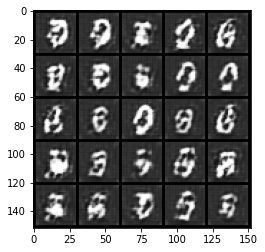

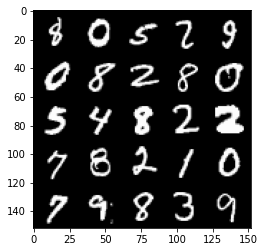

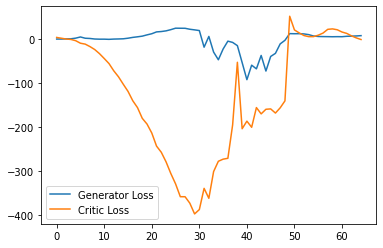

Step 1350: Generator loss: 9.082331182956695, critic loss: -9.9697804107666


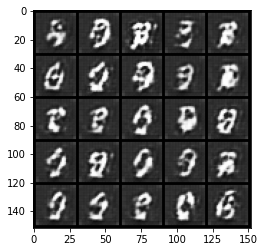

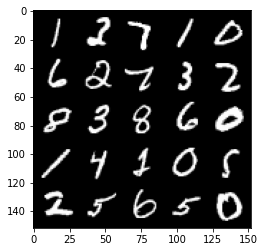

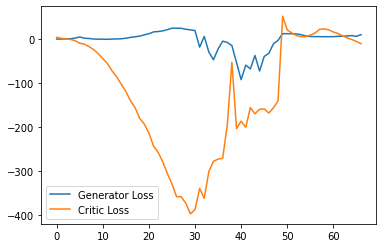

Step 1400: Generator loss: 9.49280748128891, critic loss: -13.849589065551756


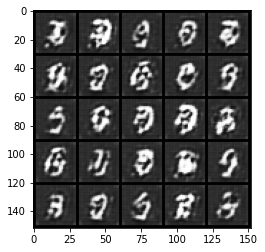

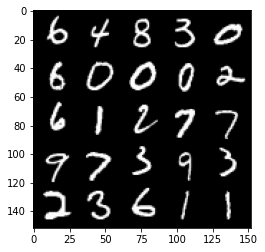

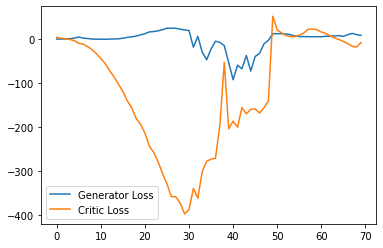

Step 1450: Generator loss: 11.473825221061707, critic loss: -23.962952529907223


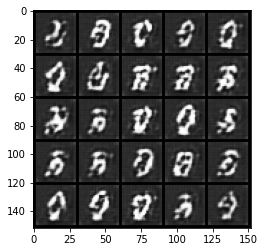

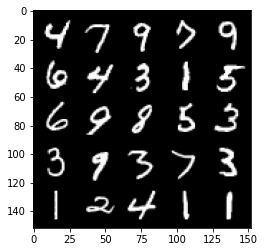

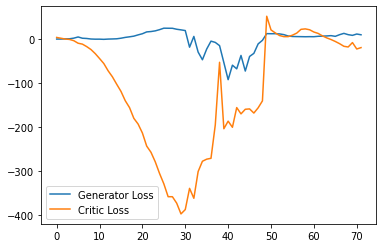

Step 1500: Generator loss: 15.49803324699402, critic loss: -28.864107597351072


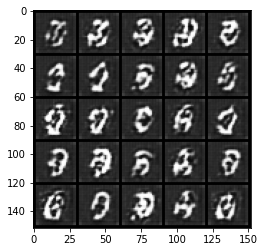

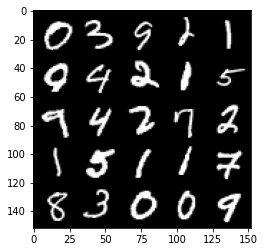

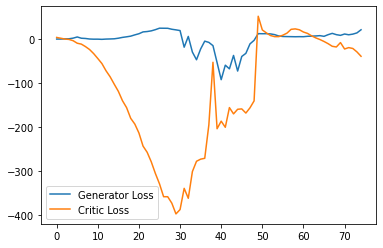

Step 1550: Generator loss: 19.396208870112897, critic loss: -14.846437240600581


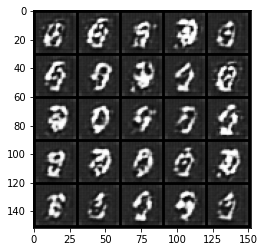

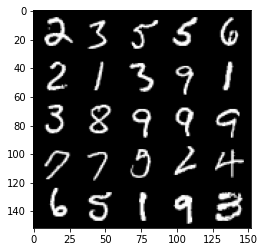

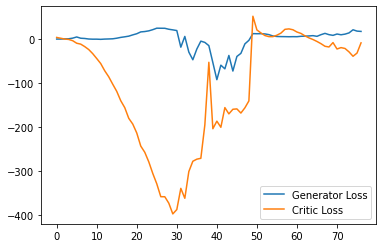

Step 1600: Generator loss: 27.117440223693848, critic loss: 7.293011985778807


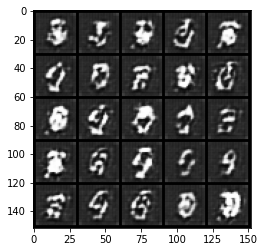

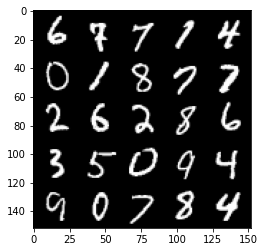

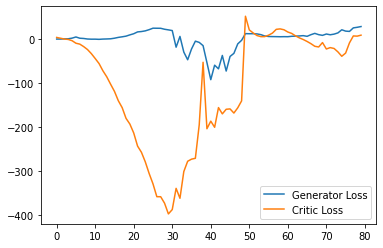

Step 1650: Generator loss: 29.307717628479004, critic loss: 7.952842727661132


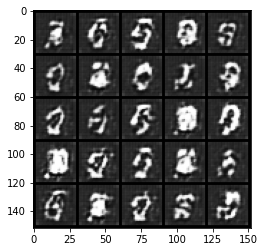

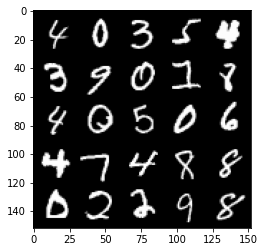

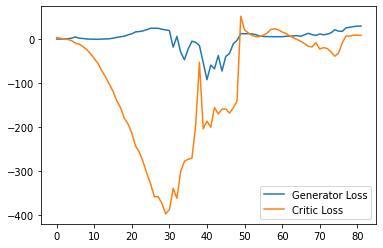

Step 1700: Generator loss: 28.016758880615235, critic loss: 4.258737289428711


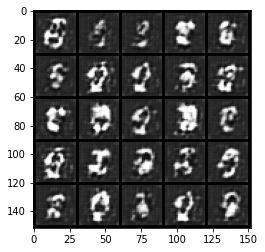

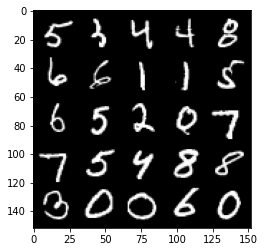

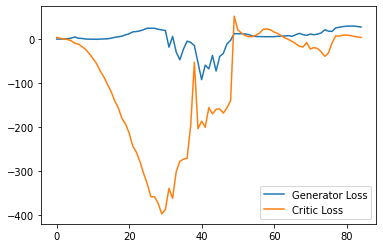

Step 1750: Generator loss: 24.582636642456055, critic loss: 1.0011846199035643


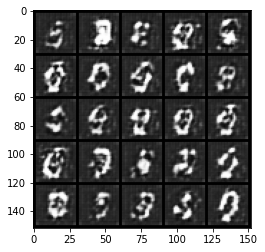

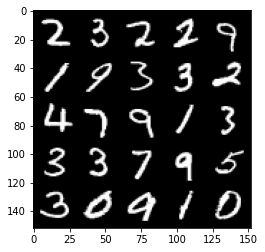

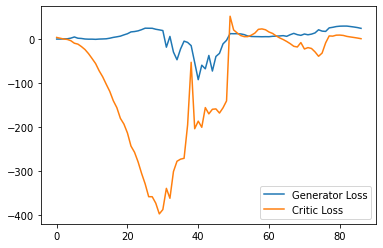

Step 1800: Generator loss: 19.963599128723146, critic loss: -1.7408038825988772


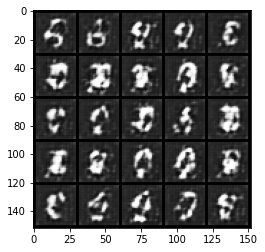

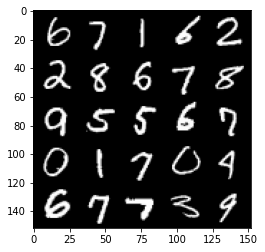

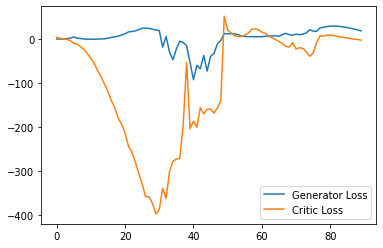

Step 1850: Generator loss: 15.201840629577637, critic loss: -5.841471473693849


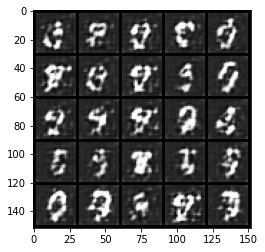

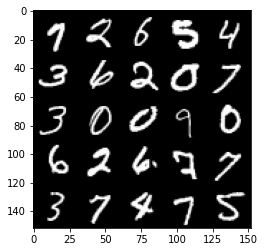

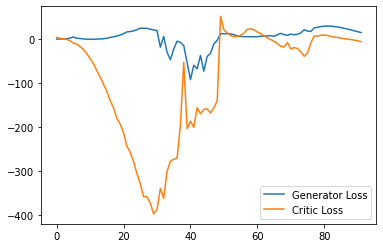

Step 1900: Generator loss: 14.850572853088378, critic loss: -15.096314674377439


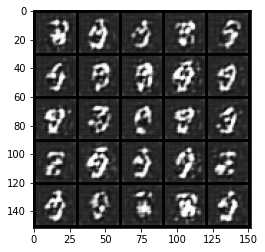

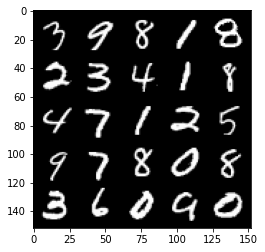

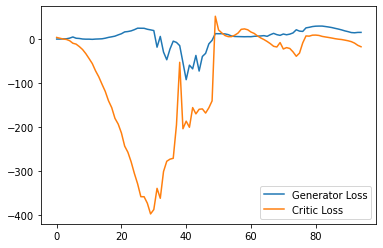

Step 1950: Generator loss: 17.63796957015991, critic loss: -20.425578323364256


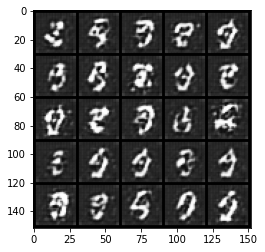

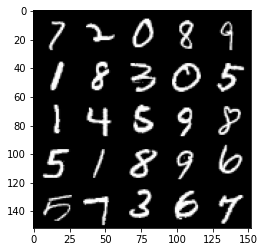

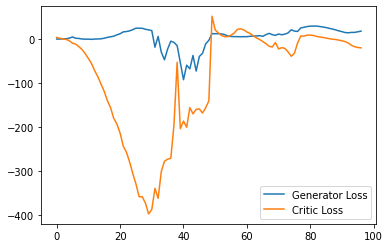

Step 2000: Generator loss: 17.27959053993225, critic loss: -21.144151304244996


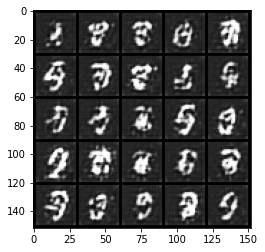

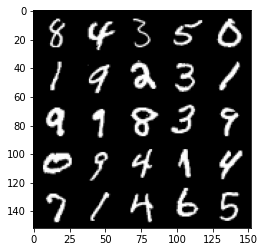

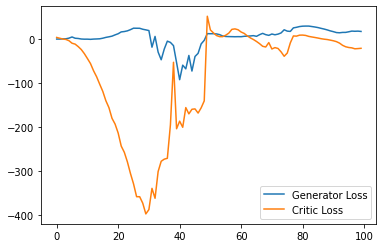

Step 2050: Generator loss: 16.596376152038573, critic loss: -25.983728179931628


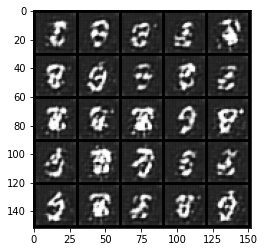

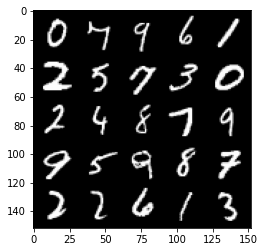

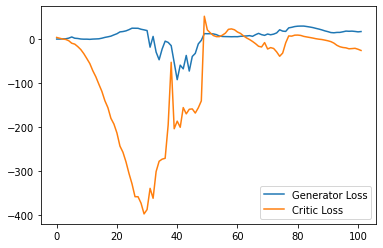

Step 2100: Generator loss: 18.919547729492187, critic loss: -26.13461232376099


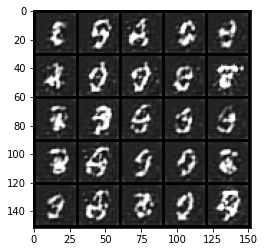

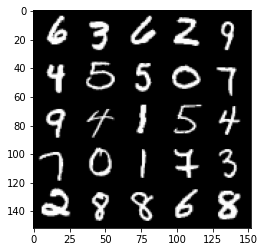

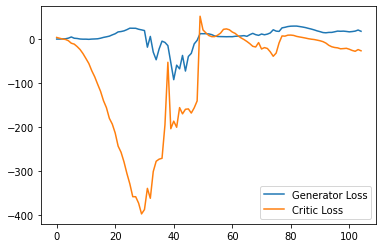

Step 2150: Generator loss: 19.93085150718689, critic loss: -28.37321315193178


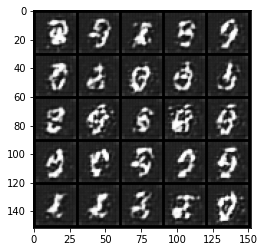

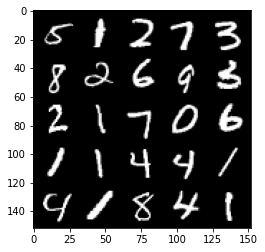

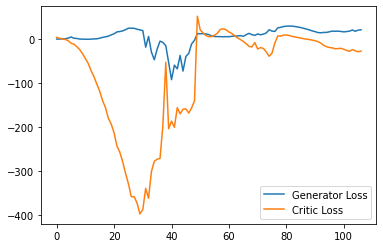

Step 2200: Generator loss: 22.324027494192123, critic loss: -28.678799907684326


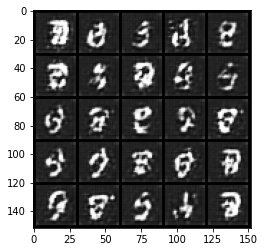

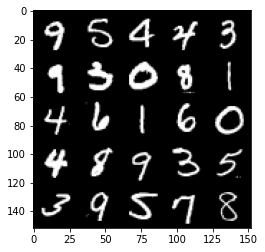

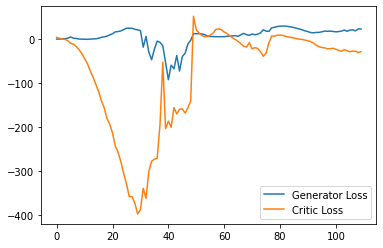

Step 2250: Generator loss: 20.459674644470216, critic loss: -22.41500861644745


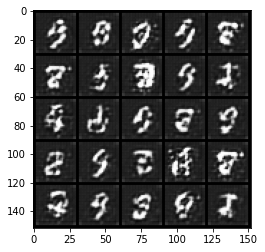

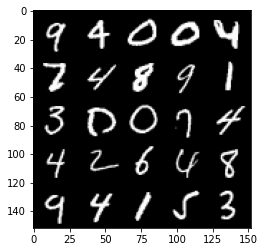

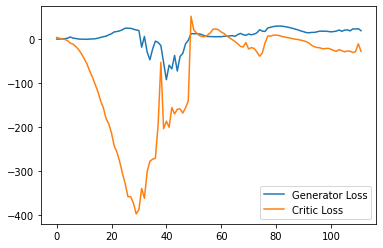

Step 2300: Generator loss: 19.44074840784073, critic loss: -29.795236143112177


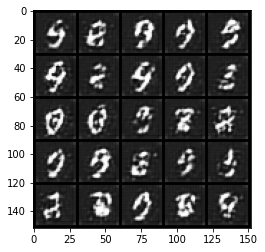

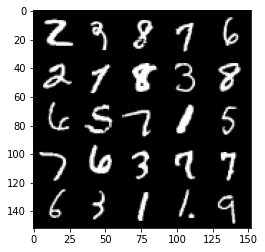

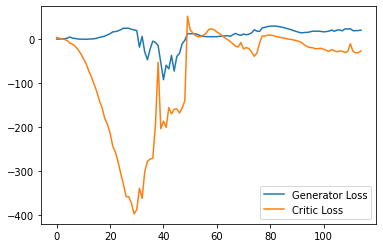

Step 2350: Generator loss: 22.544050045013428, critic loss: -26.52446265602113


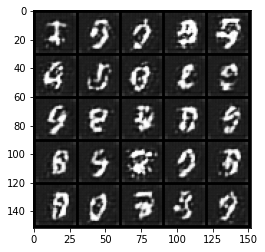

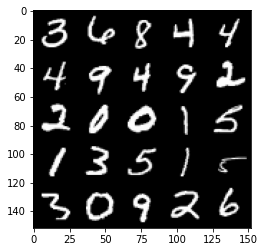

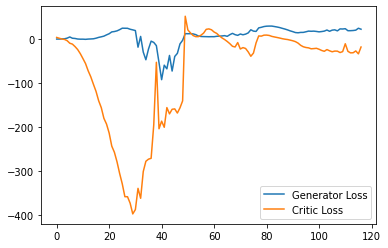

Step 2400: Generator loss: 20.945394372940065, critic loss: -32.26084210586548


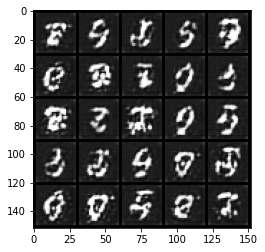

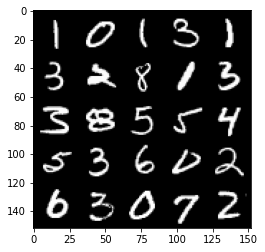

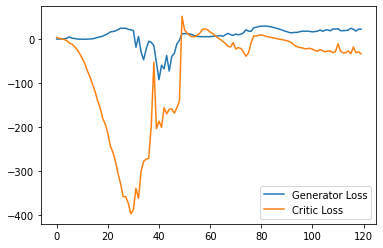

Step 2450: Generator loss: 19.59541497707367, critic loss: -24.410169637680053


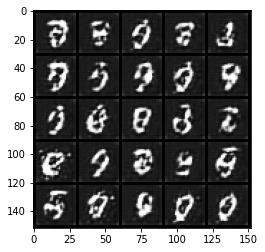

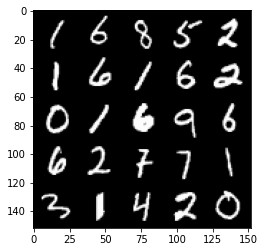

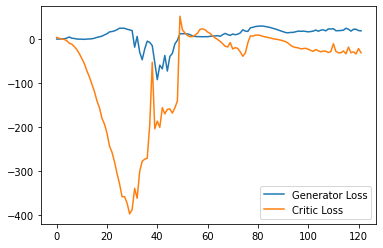

Step 2500: Generator loss: 19.527136421203615, critic loss: -26.589349333763124


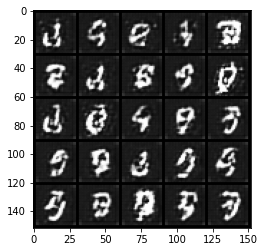

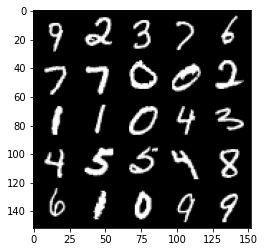

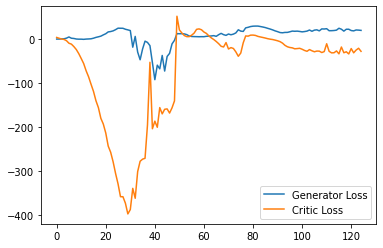

Step 2550: Generator loss: 21.75561442375183, critic loss: -7.123160737991331


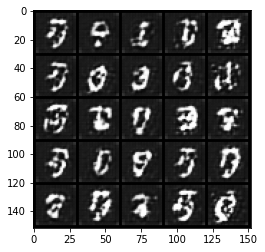

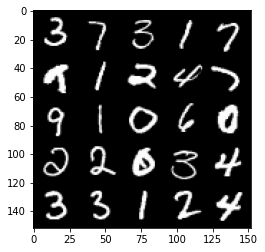

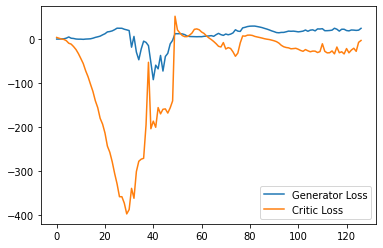

Step 2600: Generator loss: 18.816797466278075, critic loss: -17.297358842849743


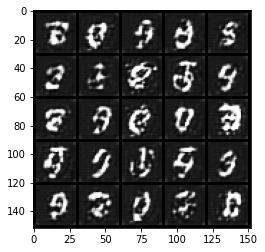

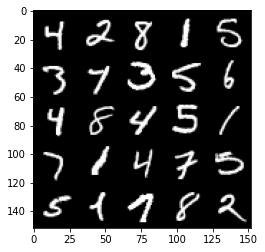

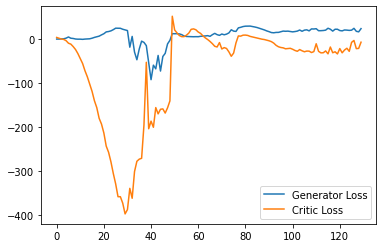

Step 2650: Generator loss: 18.0186905002594, critic loss: -18.426034545898435


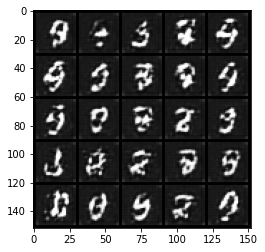

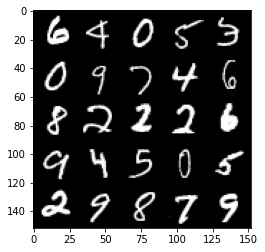

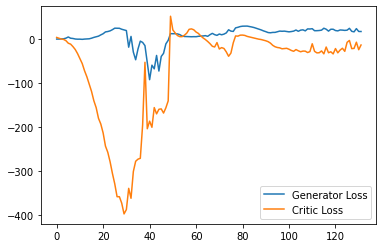

Step 2700: Generator loss: 21.145995016098023, critic loss: -14.716438879013069


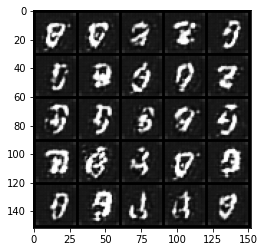

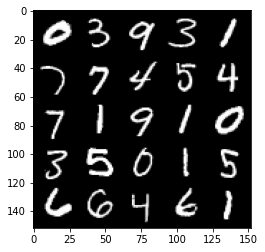

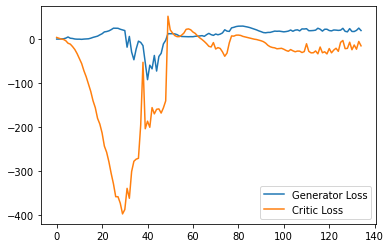

Step 2750: Generator loss: 15.116569962501526, critic loss: -25.213244970321668


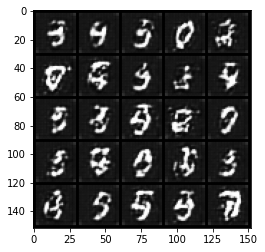

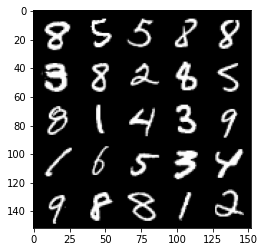

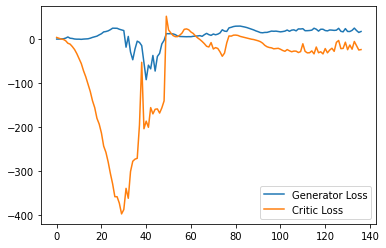

Step 2800: Generator loss: 18.60134461939335, critic loss: -13.91210597705841


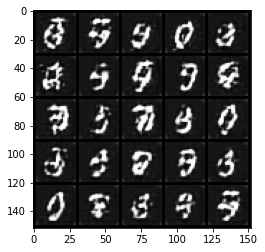

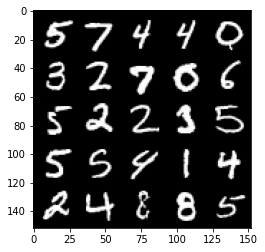

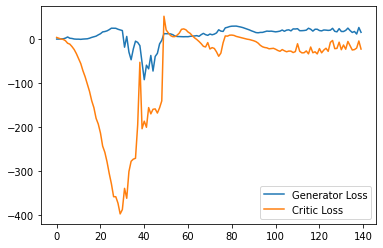

Step 2850: Generator loss: 26.660213317871094, critic loss: -1.6834075756073


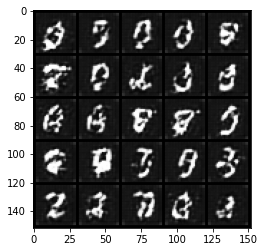

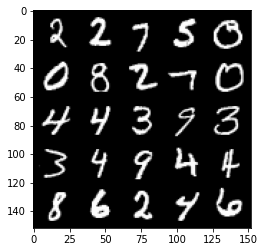

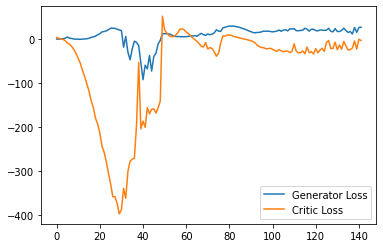

Step 2900: Generator loss: 21.12049005508423, critic loss: -8.395728598594665


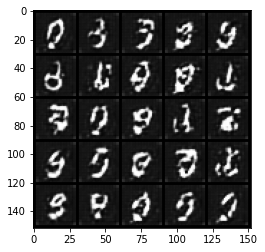

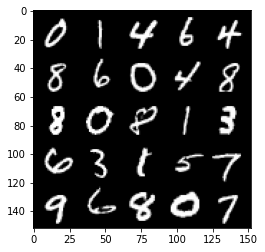

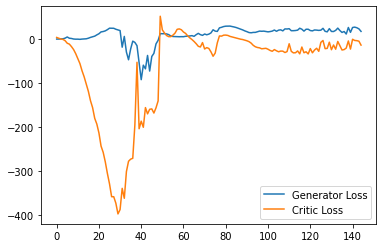

Step 2950: Generator loss: 18.58918605208397, critic loss: -4.889795348167418


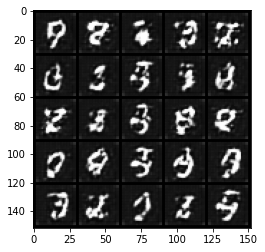

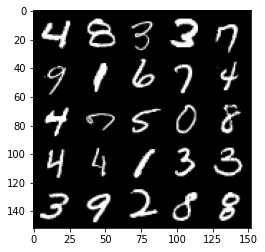

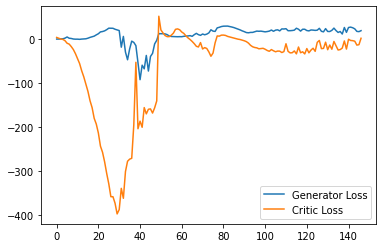

Step 3000: Generator loss: 21.37620292663574, critic loss: -2.2983645572662352


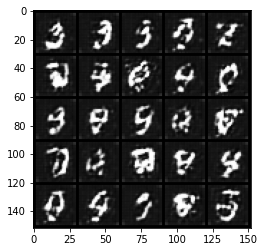

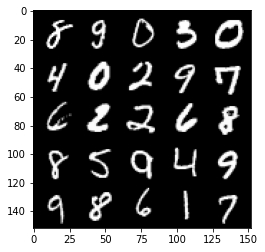

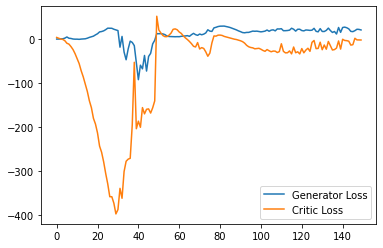

Step 3050: Generator loss: 18.396858596801756, critic loss: -2.411460578918457


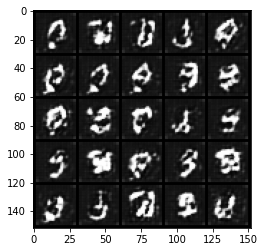

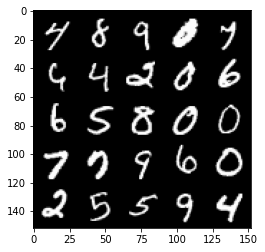

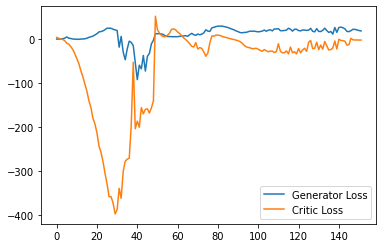

Step 3100: Generator loss: 15.931731395721435, critic loss: -2.825876568794251


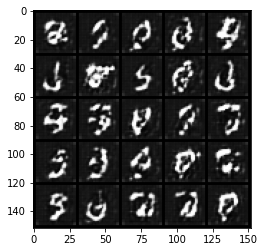

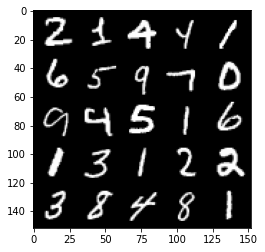

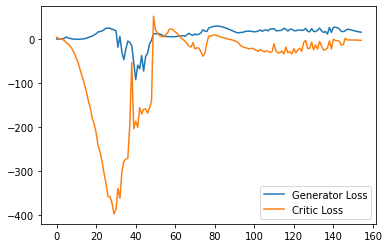

Step 3150: Generator loss: 12.488281302452087, critic loss: -8.03450852394104


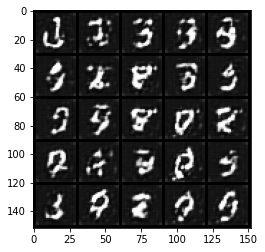

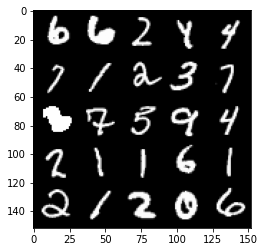

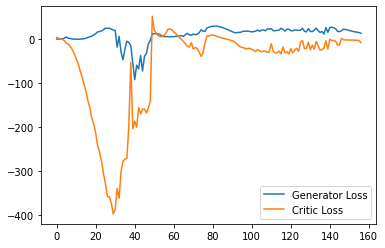

Step 3200: Generator loss: 17.135860285758973, critic loss: -4.746284446239472


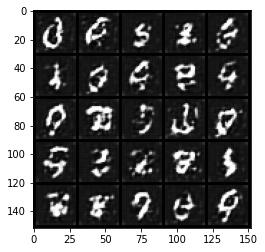

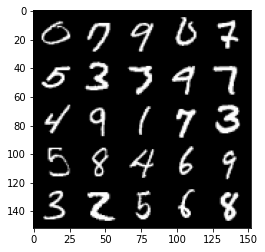

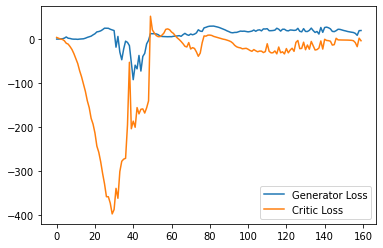

Step 3250: Generator loss: 11.349668869972229, critic loss: -16.757577256202698


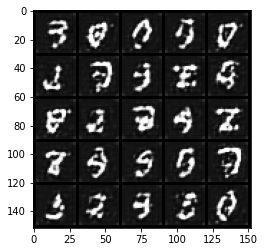

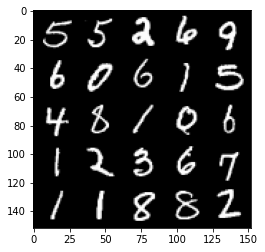

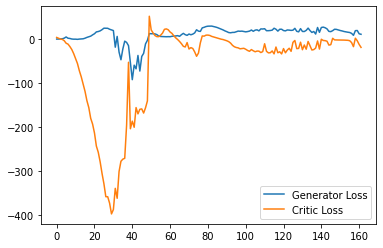

Step 3300: Generator loss: 14.182445220947265, critic loss: -17.68197076416016


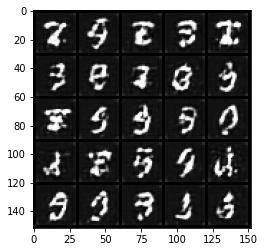

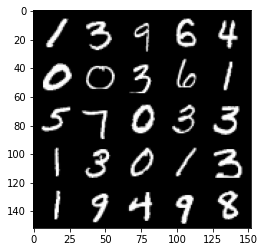

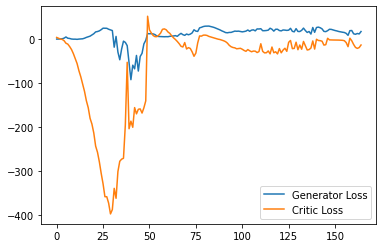

Step 3350: Generator loss: 18.801490268707276, critic loss: -13.365346363067628


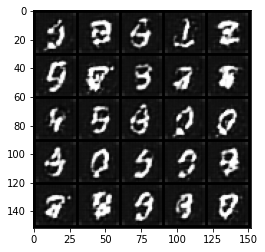

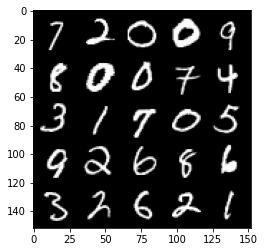

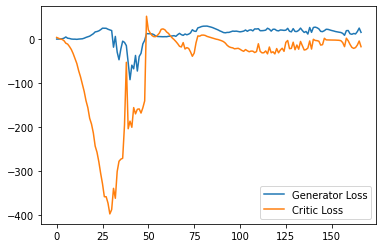

Step 3400: Generator loss: 18.853026361465453, critic loss: -14.567557167053225


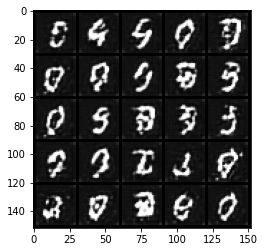

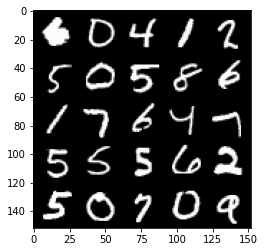

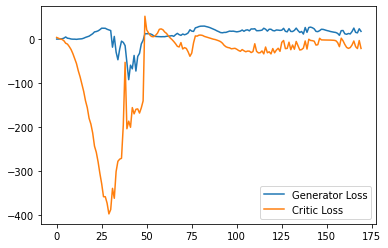

Step 3450: Generator loss: 18.270262906551363, critic loss: -19.7053653383255


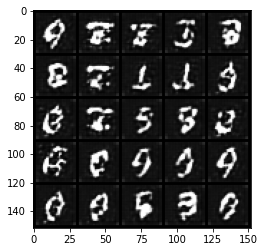

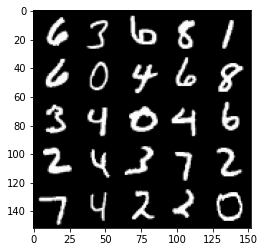

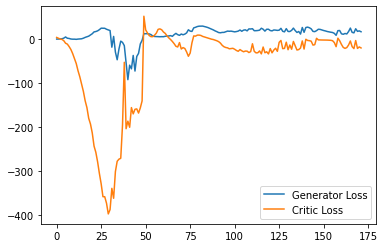

Step 3500: Generator loss: 19.794816393852233, critic loss: -18.961203214645387


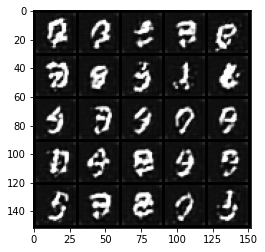

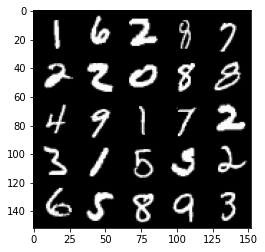

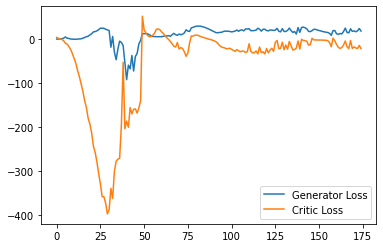

Step 3550: Generator loss: 29.194484100341796, critic loss: -4.323153131008148


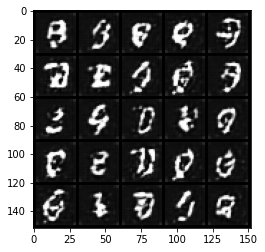

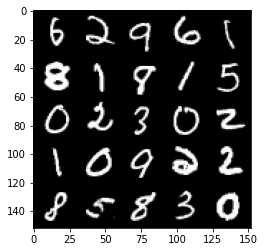

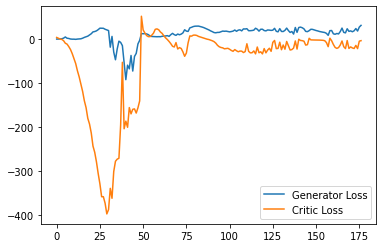

Step 3600: Generator loss: 22.86488363265991, critic loss: -6.809849300384522


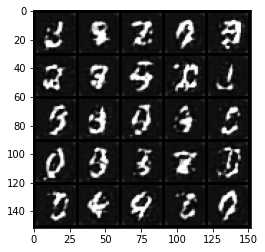

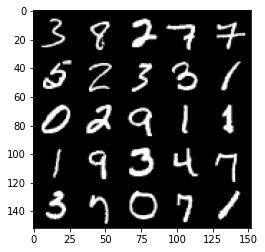

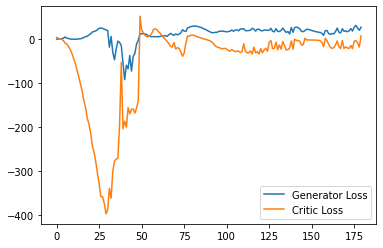

Step 3650: Generator loss: 31.190156364440917, critic loss: -2.346043608188629


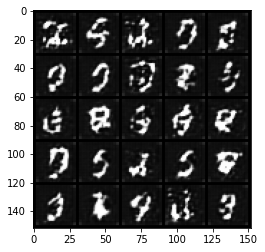

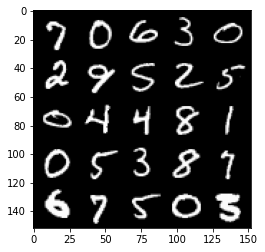

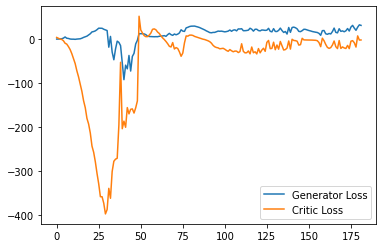

Step 3700: Generator loss: 27.631607131958006, critic loss: -2.261190236091614


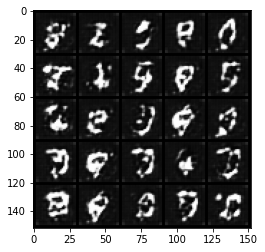

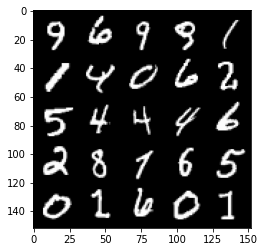

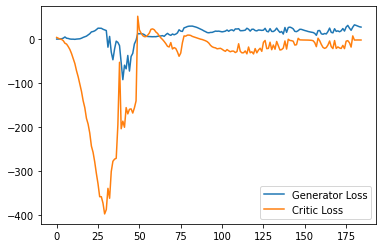

Step 3750: Generator loss: 25.557422752380372, critic loss: -2.4773188228607177


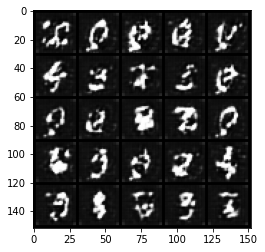

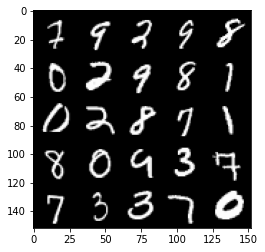

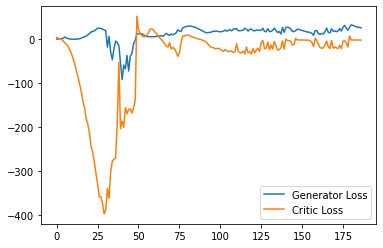

Step 3800: Generator loss: 23.728539276123048, critic loss: -2.8550474414825437


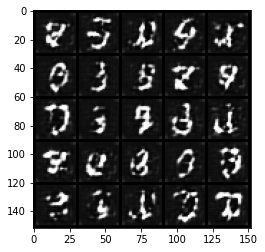

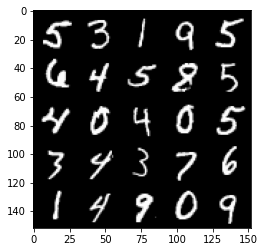

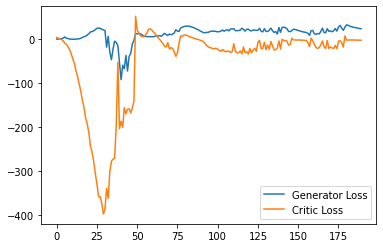

Step 3850: Generator loss: 22.316627349853515, critic loss: -4.053320799827576


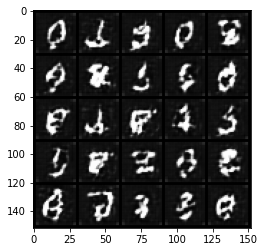

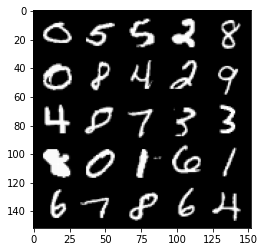

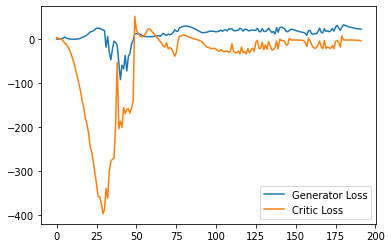

Step 3900: Generator loss: 19.932986226081848, critic loss: -1.9687523050308213


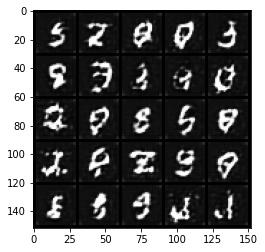

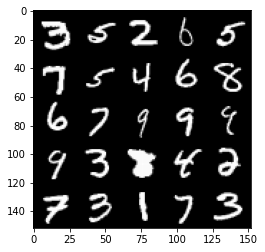

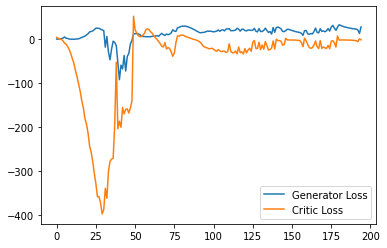

Step 3950: Generator loss: 25.731414489746093, critic loss: -1.9609302949905398


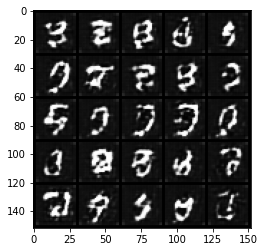

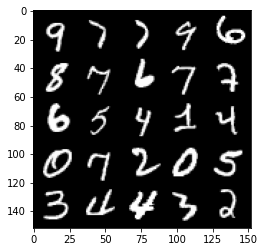

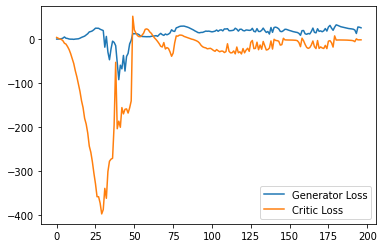

Step 4000: Generator loss: 23.836305770874024, critic loss: -2.1787744016647337


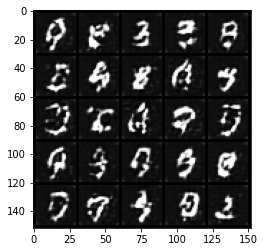

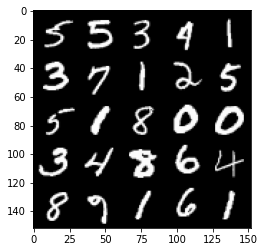

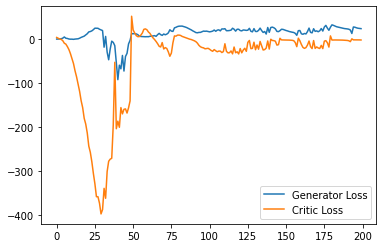

Step 4050: Generator loss: 23.328018760681154, critic loss: -2.4946560459136964


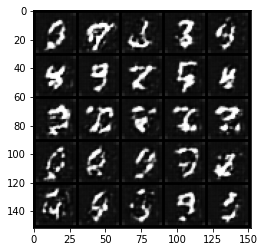

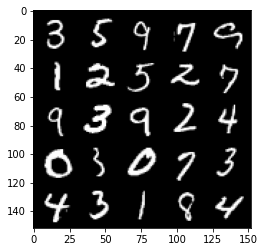

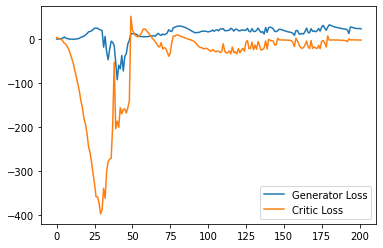

Step 4100: Generator loss: 22.797510147094727, critic loss: -2.931338985443115


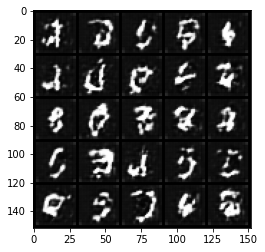

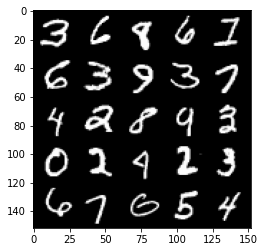

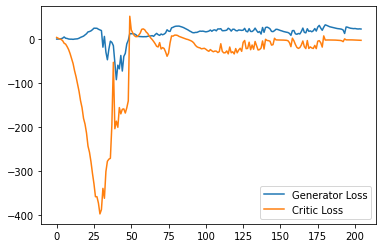

Step 4150: Generator loss: 22.15837585449219, critic loss: -3.5328629627227777


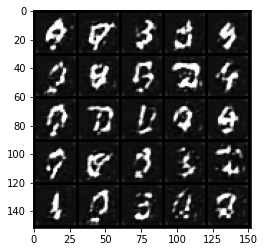

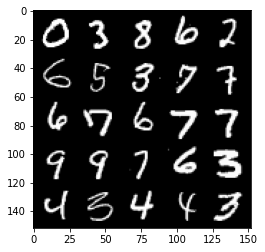

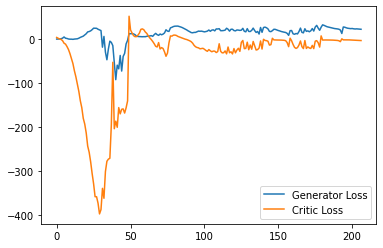

Step 4200: Generator loss: 21.59904083251953, critic loss: -4.4754381809234625


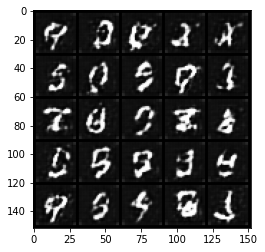

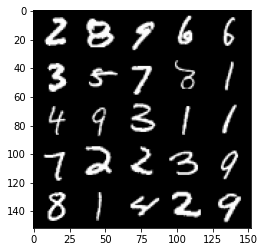

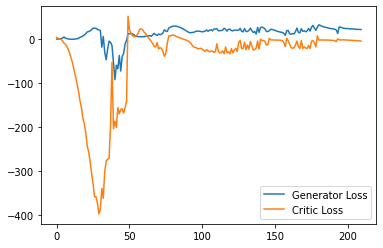

Step 4250: Generator loss: 21.3235758972168, critic loss: -2.314643280982972


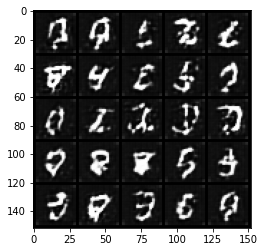

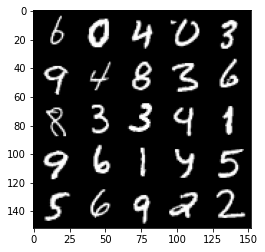

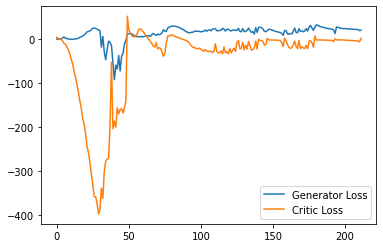

Step 4300: Generator loss: 26.349516334533693, critic loss: -2.108071353912353


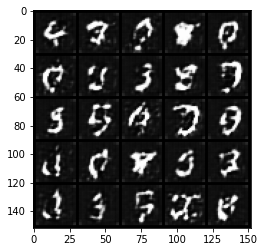

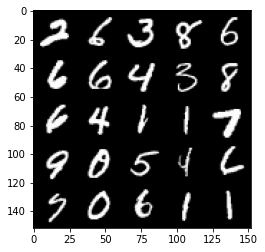

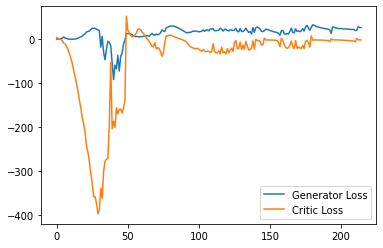

Step 4350: Generator loss: 24.240829887390138, critic loss: -2.6503652677536014


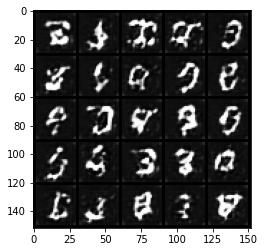

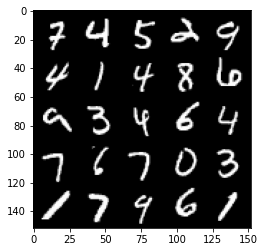

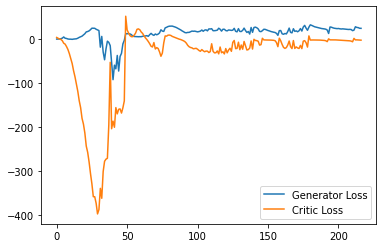

Step 4400: Generator loss: 23.463974227905272, critic loss: -3.7120025615692147


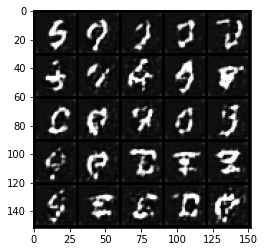

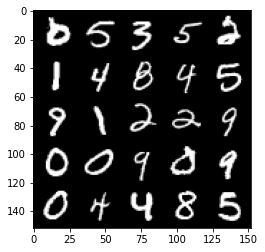

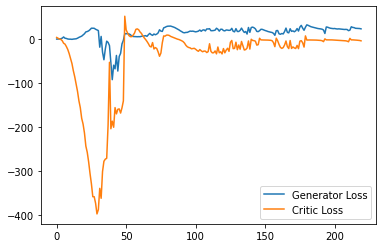

Step 4450: Generator loss: 18.01701301574707, critic loss: -11.34569165229797


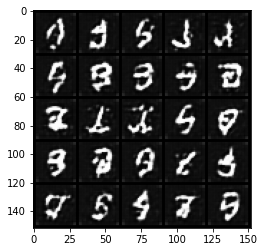

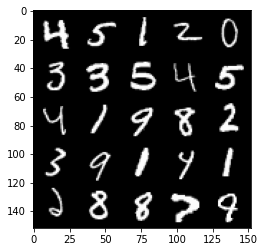

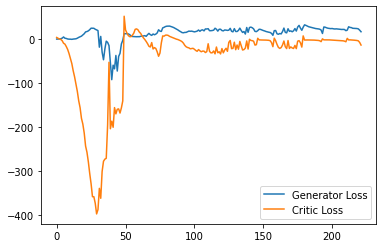

Step 4500: Generator loss: 20.71369194507599, critic loss: -14.810800449371335


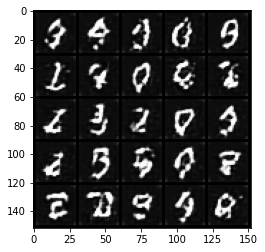

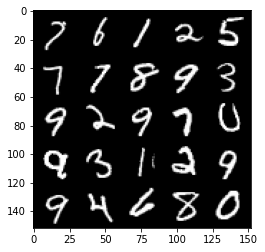

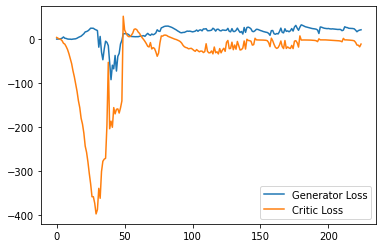

Step 4550: Generator loss: 22.457683963775636, critic loss: -15.70653715419769


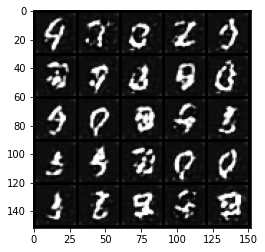

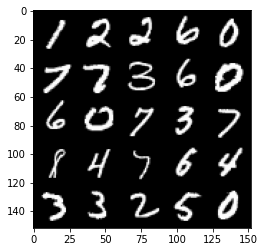

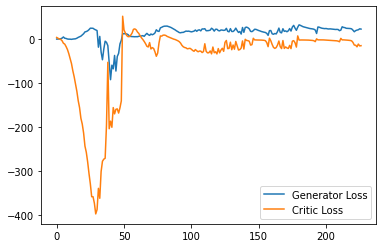

Step 4600: Generator loss: 27.560349655151366, critic loss: -10.282516040802006


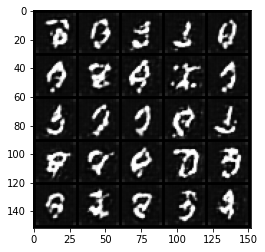

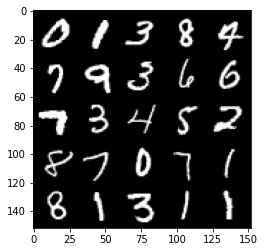

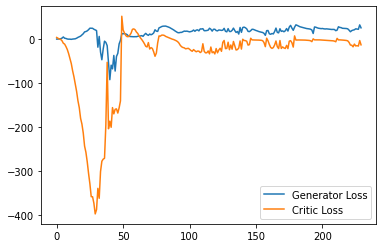

Step 4650: Generator loss: 27.005053367614746, critic loss: -9.485778059482572


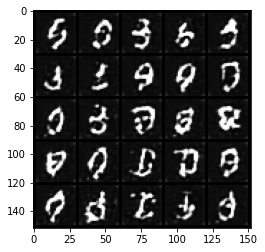

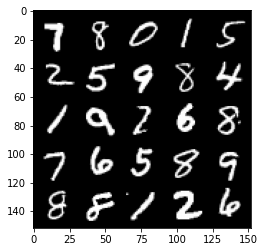

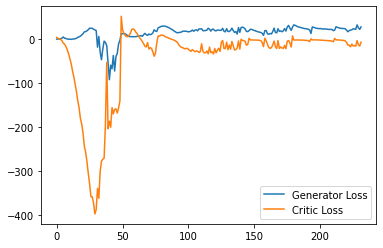

Step 4700: Generator loss: 32.82725799560547, critic loss: -3.699874708175659


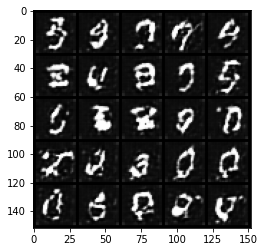

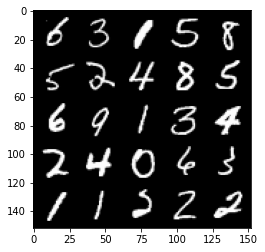

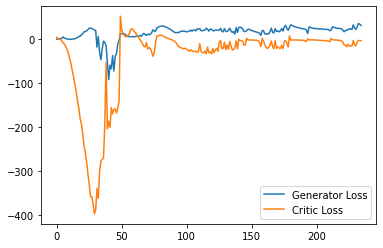

Step 4750: Generator loss: 25.526781692504883, critic loss: -13.004477916717528


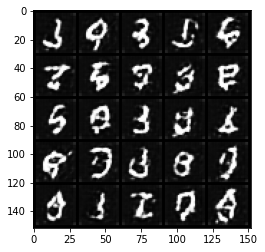

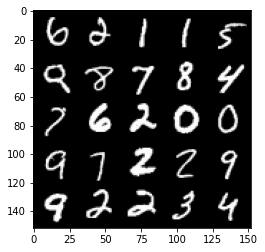

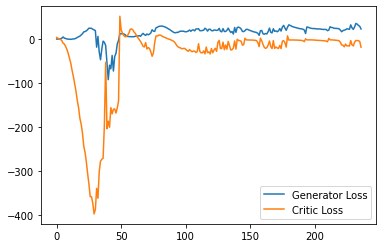

Step 4800: Generator loss: 25.06963228225708, critic loss: -18.76543175935745


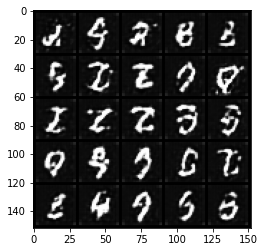

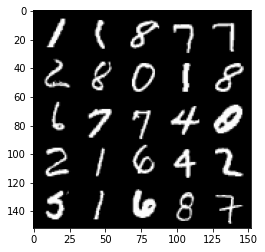

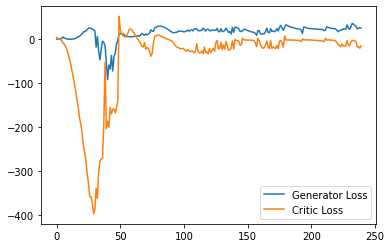

Step 4850: Generator loss: 27.47222309112549, critic loss: -16.257140542984008


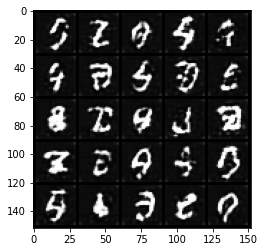

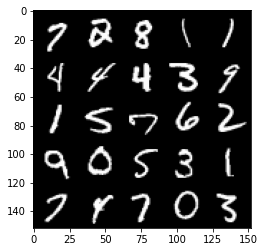

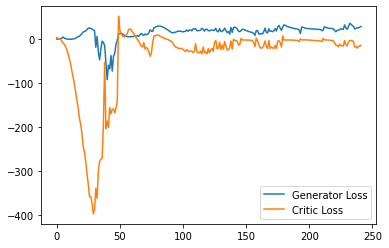

Step 4900: Generator loss: 33.24397559165955, critic loss: -3.12910117816925


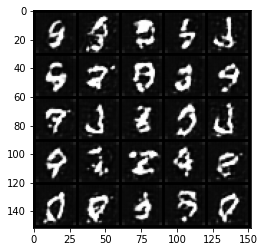

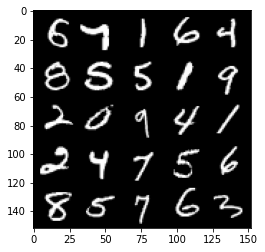

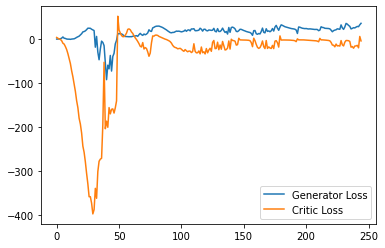

Step 4950: Generator loss: 25.41236804962158, critic loss: -13.93350718784332


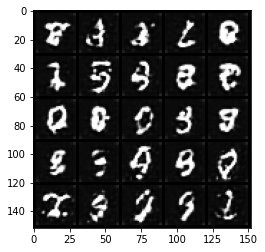

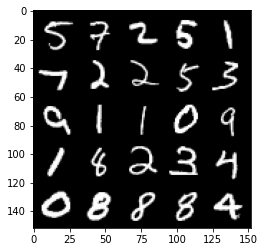

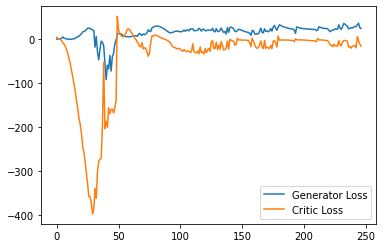

Step 5000: Generator loss: 31.047389640808106, critic loss: -11.85453970813751


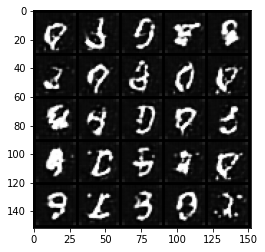

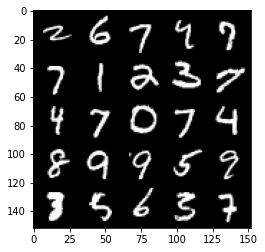

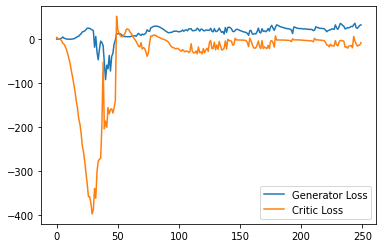

Step 5050: Generator loss: 29.167315940856934, critic loss: -10.613889157295226


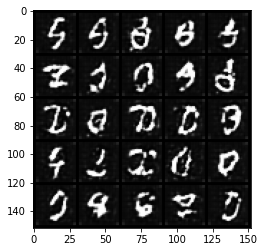

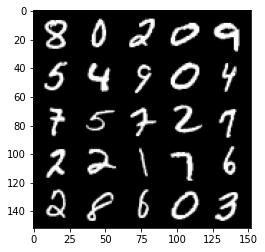

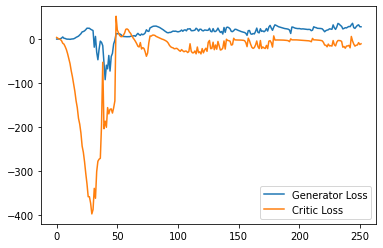

Step 5100: Generator loss: 26.16364013671875, critic loss: -16.299142774105075


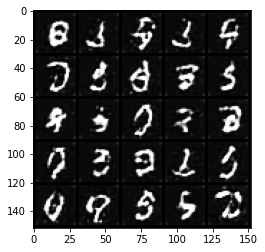

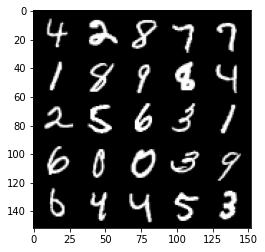

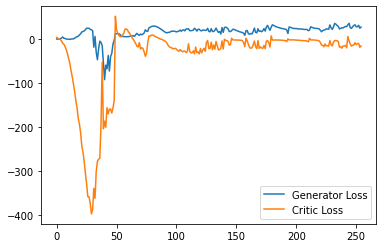

Step 5150: Generator loss: 25.498261604309082, critic loss: -8.029843168258669


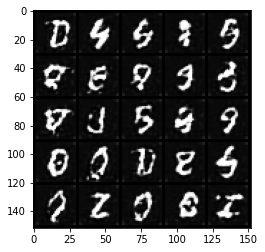

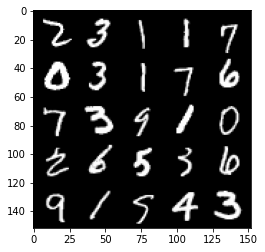

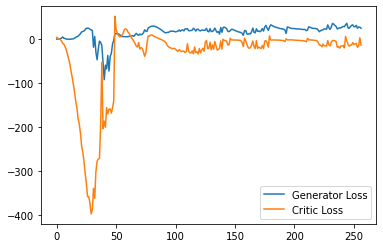

Step 5200: Generator loss: 28.806849822998046, critic loss: -16.591686217308048


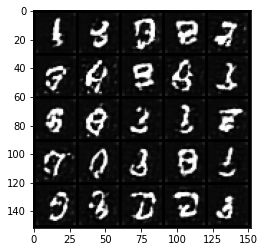

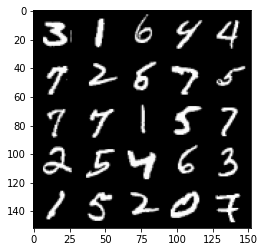

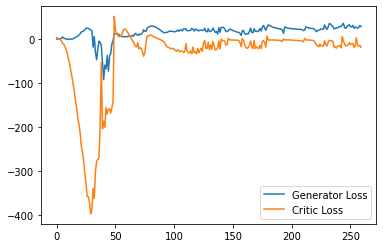

Step 5250: Generator loss: 30.226981544494627, critic loss: -14.428750833511351


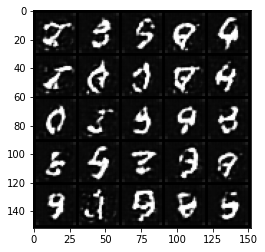

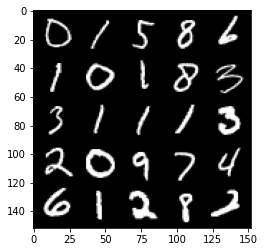

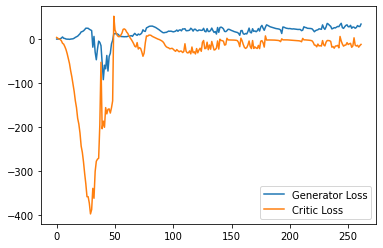

Step 5300: Generator loss: 31.195589981079102, critic loss: -14.914404158592225


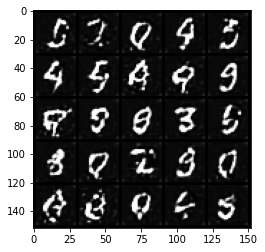

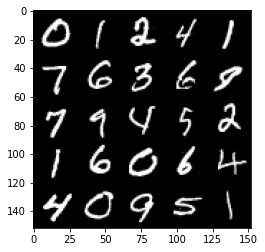

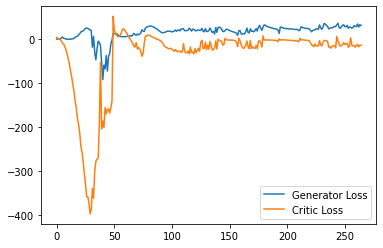

Step 5350: Generator loss: 32.07564380645752, critic loss: -15.274536674499513


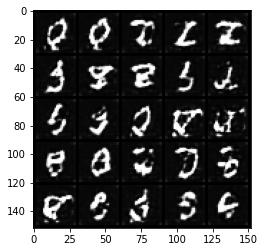

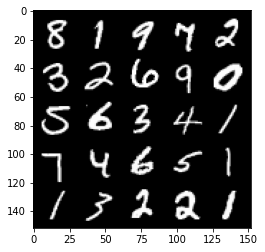

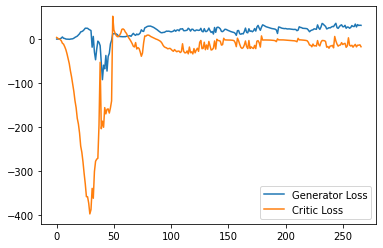

Step 5400: Generator loss: 28.30336673736572, critic loss: -15.336679639816284


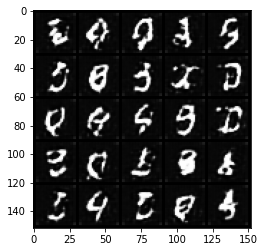

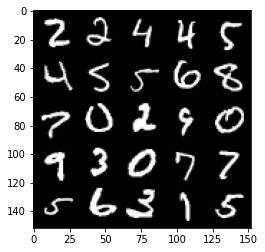

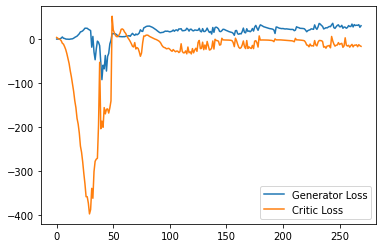

Step 5450: Generator loss: 33.29697824478149, critic loss: -7.646651312828063


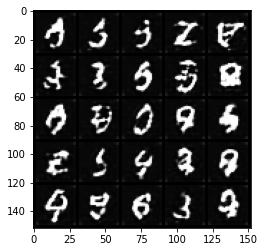

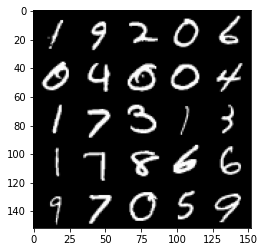

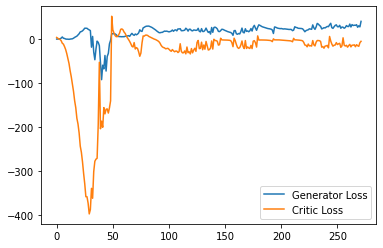

Step 5500: Generator loss: 33.14010757446289, critic loss: -14.60584149837494


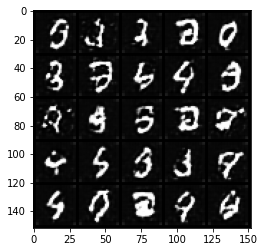

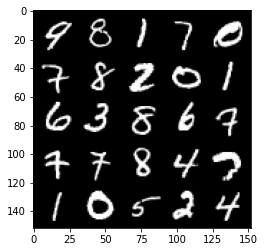

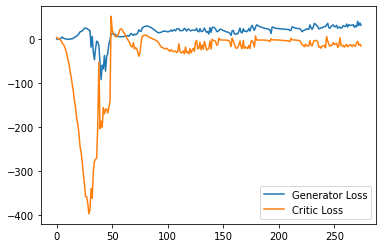

Step 5550: Generator loss: 30.69924503326416, critic loss: -16.65513962841034


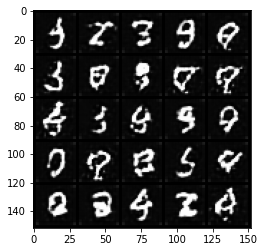

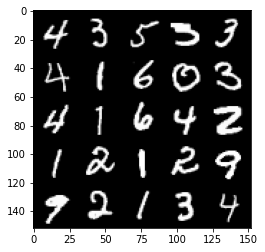

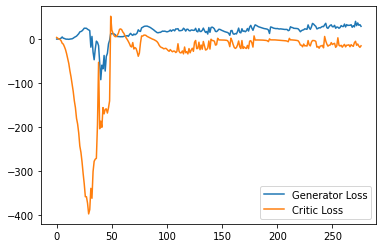

Step 5600: Generator loss: 35.34023281097412, critic loss: -9.452937292098998


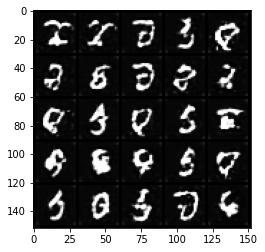

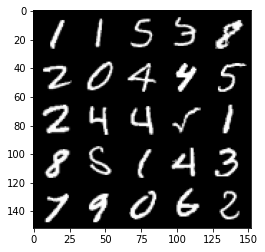

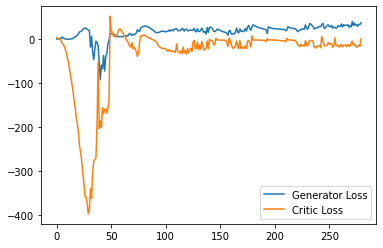

Step 5650: Generator loss: 34.84008785247803, critic loss: -14.365937769412994


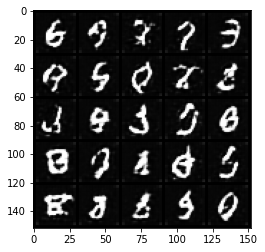

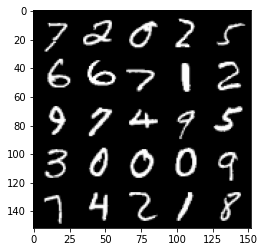

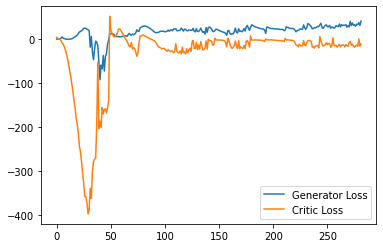

Step 5700: Generator loss: 35.488672714233395, critic loss: -13.36760533905029


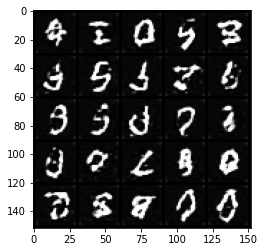

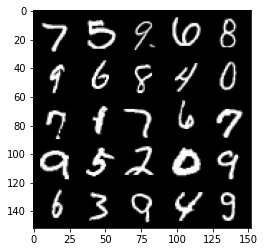

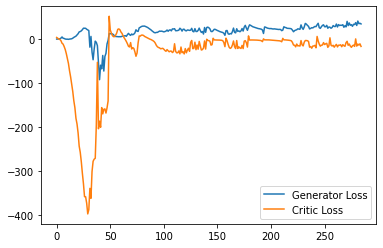

Step 5750: Generator loss: 32.505680046081544, critic loss: -15.911165381908422


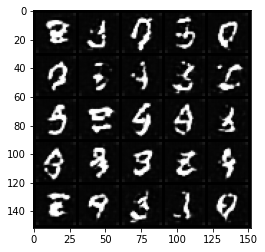

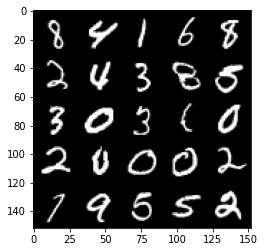

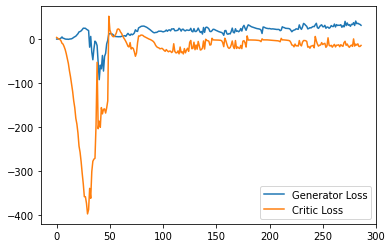

Step 5800: Generator loss: 37.3402201461792, critic loss: -16.513195205688476


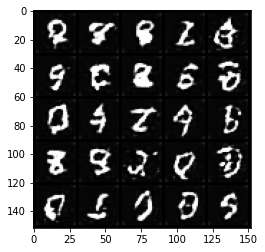

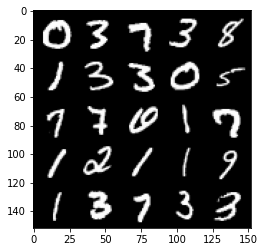

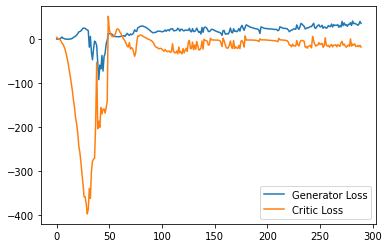

Step 5850: Generator loss: 38.730593338012696, critic loss: 2.0680181550979633


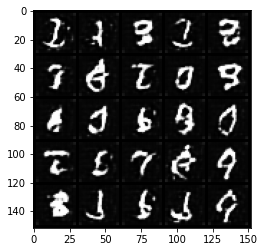

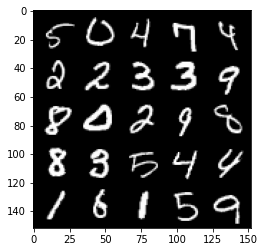

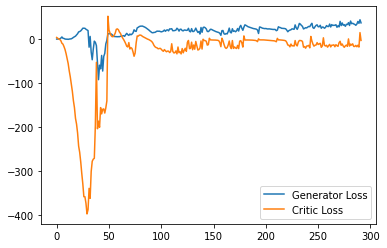

Step 5900: Generator loss: 38.35961711883545, critic loss: -9.363144178867342


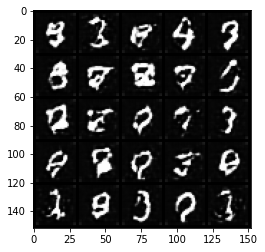

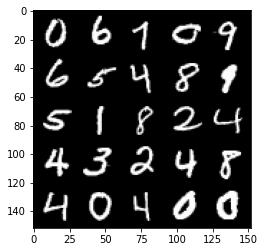

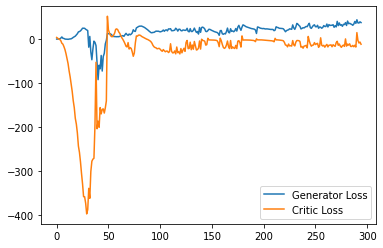

Step 5950: Generator loss: 34.136236114501955, critic loss: -15.039948026180266


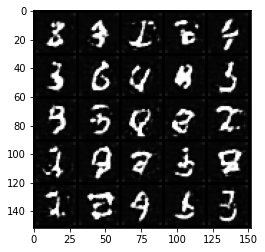

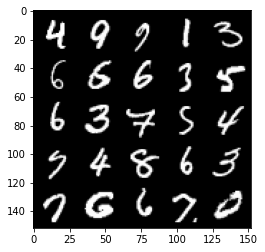

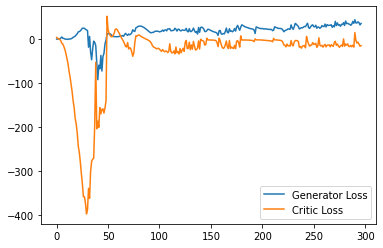

Step 6000: Generator loss: 40.76417121887207, critic loss: -11.20152116727829


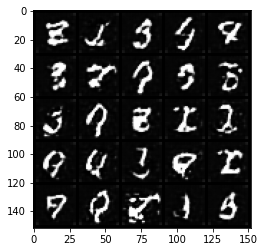

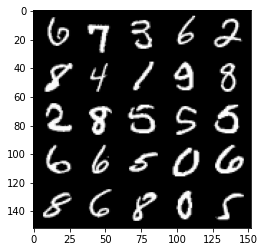

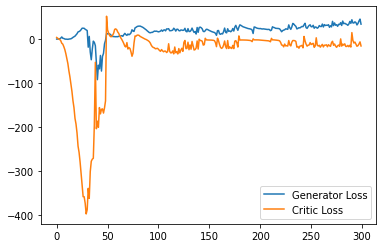

Step 6050: Generator loss: 38.57671688079834, critic loss: -13.784642446517946


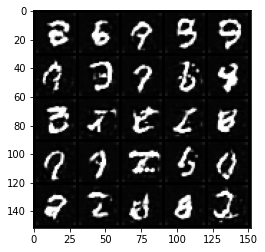

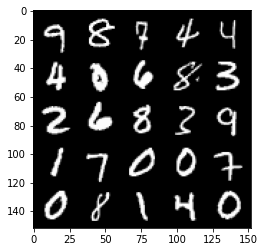

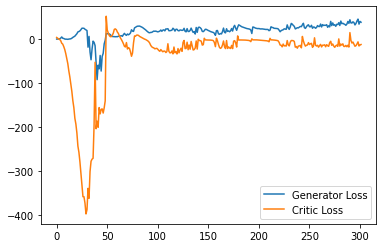

Step 6100: Generator loss: 35.14928043365479, critic loss: -16.34903343105316


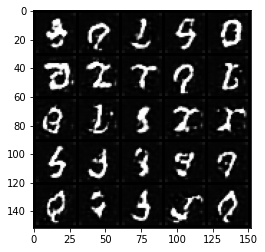

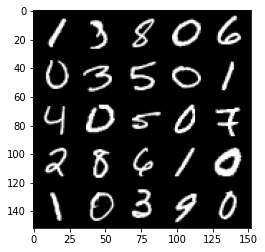

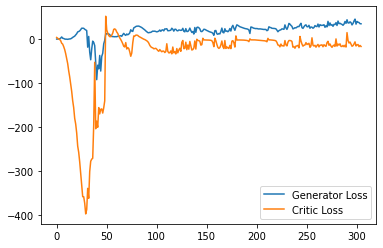

Step 6150: Generator loss: 40.85406227111817, critic loss: -13.915167604446406


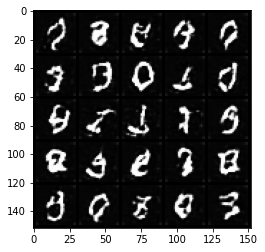

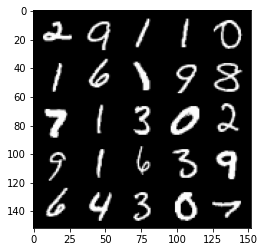

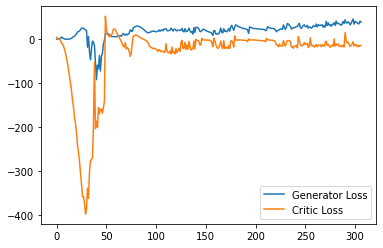

Step 6200: Generator loss: 45.08570358276367, critic loss: -4.271025516033176


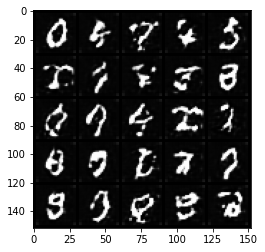

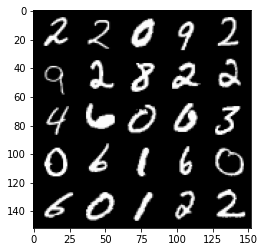

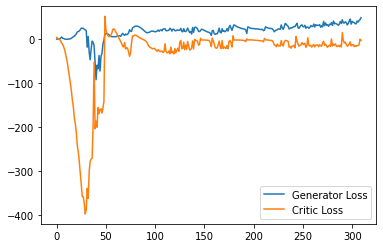

Step 6250: Generator loss: 45.71587890625, critic loss: -3.695547941207884


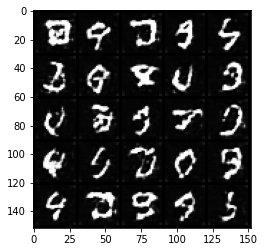

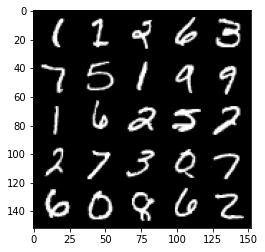

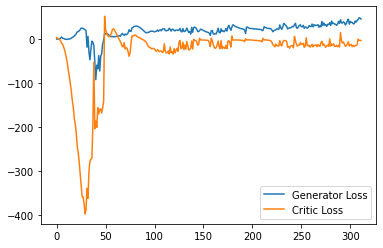

Step 6300: Generator loss: 39.97095375061035, critic loss: -11.645020188331603


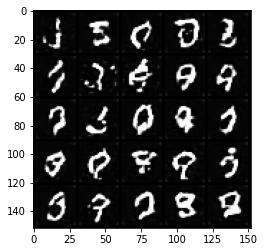

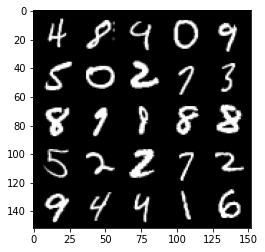

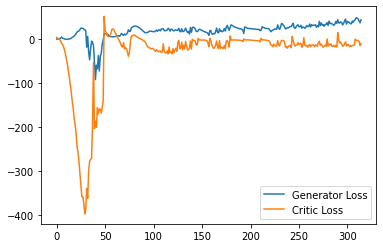

Step 6350: Generator loss: 39.23448459625244, critic loss: -14.705763689994813


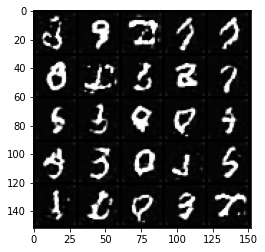

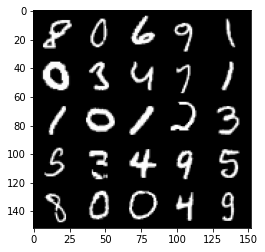

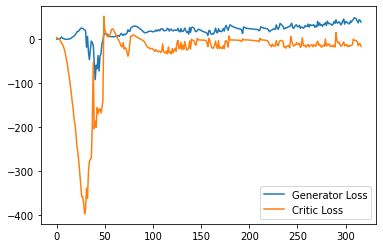

Step 6400: Generator loss: 43.54434070587158, critic loss: -13.595064330101016


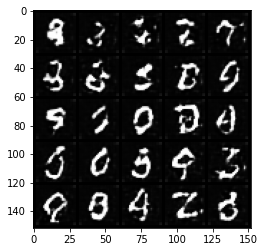

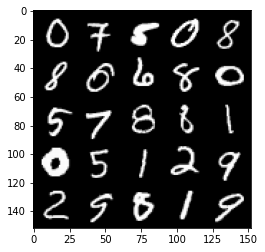

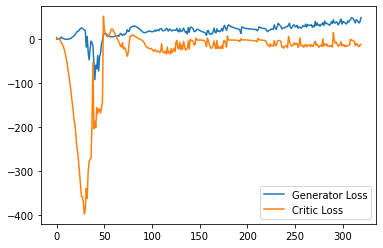

Step 6450: Generator loss: 45.93776222229004, critic loss: -10.382500971317292


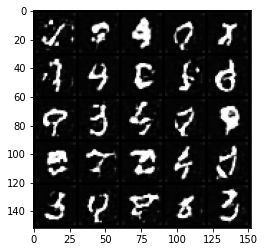

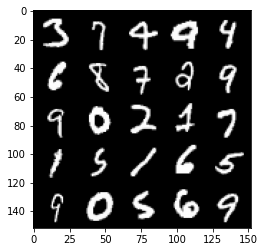

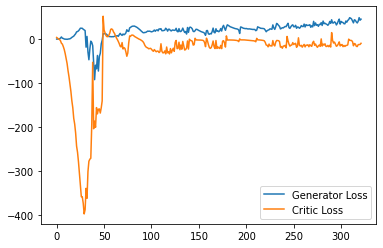

Step 6500: Generator loss: 42.6808432006836, critic loss: -12.22309651136398


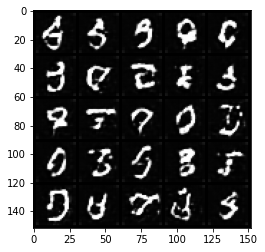

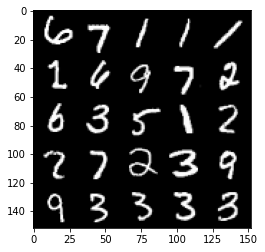

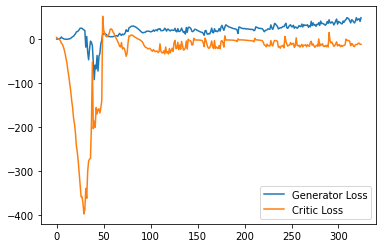

Step 6550: Generator loss: 42.875691452026366, critic loss: -11.449655516147612


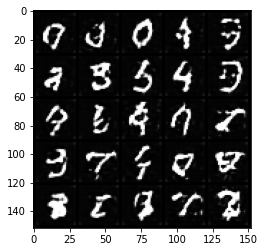

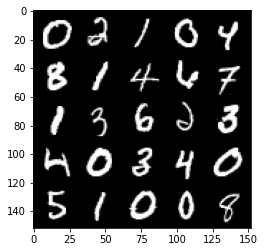

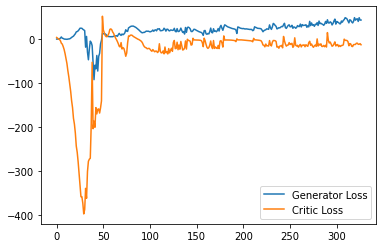

Step 6600: Generator loss: 43.54905883789063, critic loss: -13.069713958740232


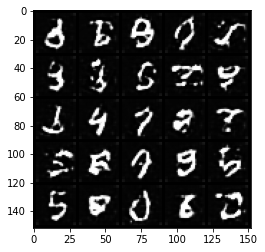

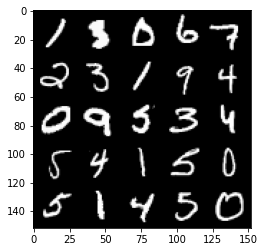

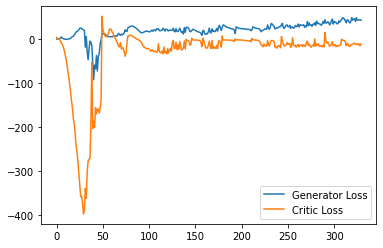

Step 6650: Generator loss: 43.38232391357422, critic loss: -8.237533167839048


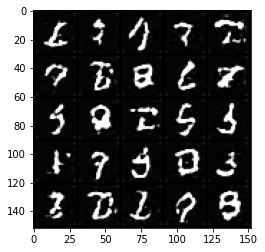

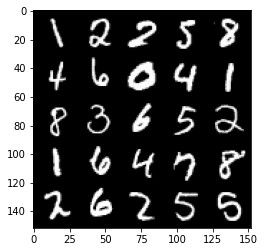

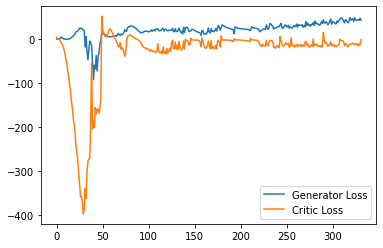

Step 6700: Generator loss: 45.040890579223635, critic loss: -12.604498550415038


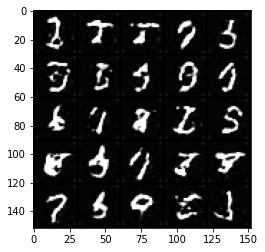

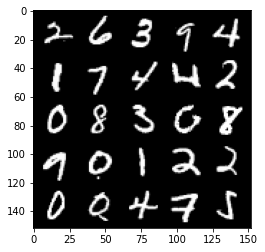

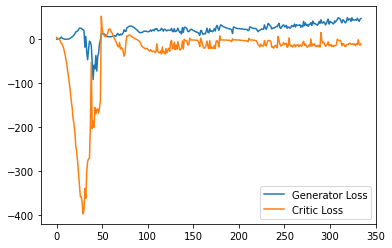

Step 6750: Generator loss: 47.70543460845947, critic loss: -8.897675870895384


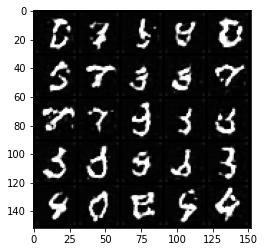

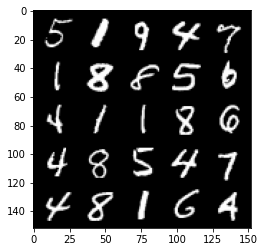

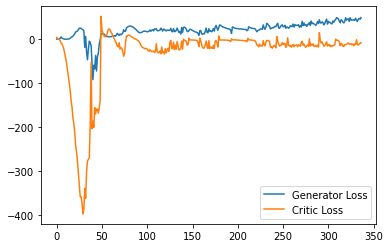

Step 6800: Generator loss: 44.26542694091797, critic loss: -12.779143367767336


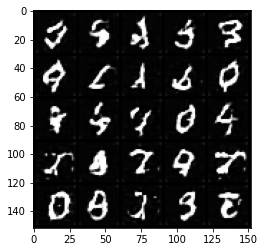

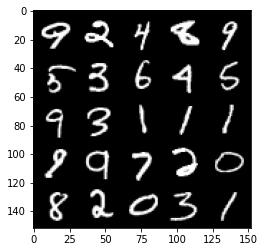

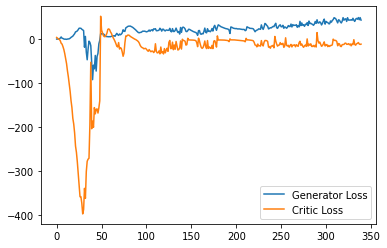

Step 6850: Generator loss: 48.5761376953125, critic loss: -11.996850137710572


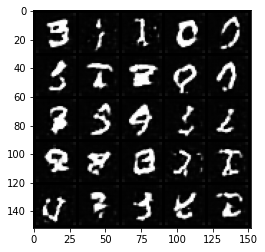

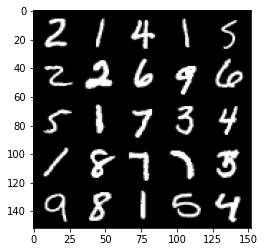

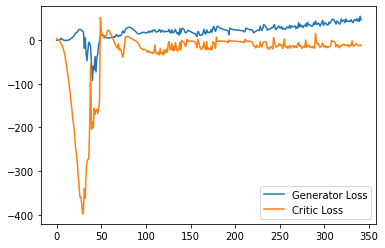

Step 6900: Generator loss: 40.4715767288208, critic loss: -15.039243598461155


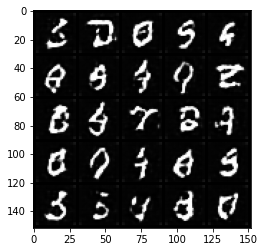

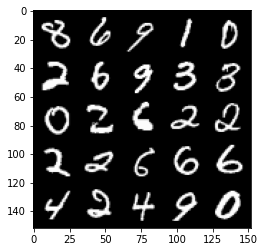

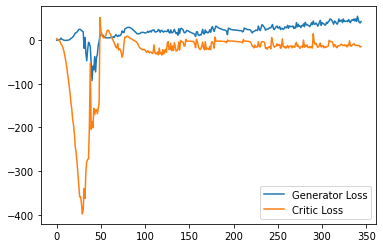

Step 6950: Generator loss: 48.935872116088866, critic loss: -8.37076402378082


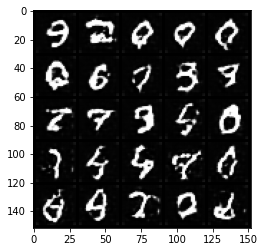

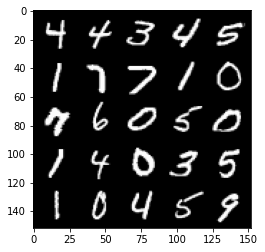

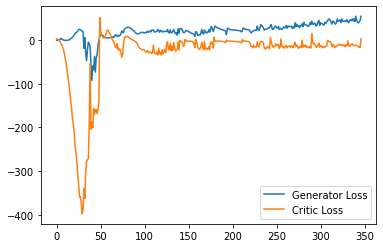

Step 7000: Generator loss: 48.17398132324219, critic loss: -14.155920948505404


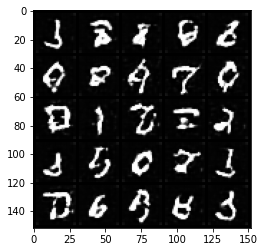

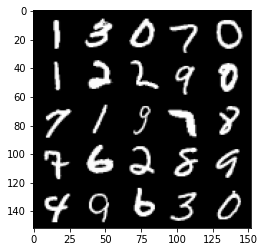

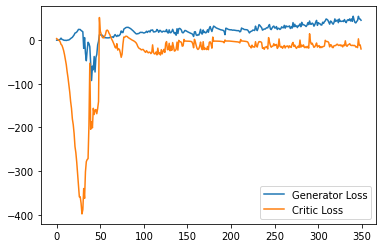

Step 7050: Generator loss: 52.78936134338379, critic loss: -10.04038856124878


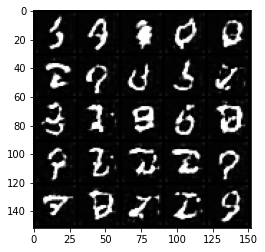

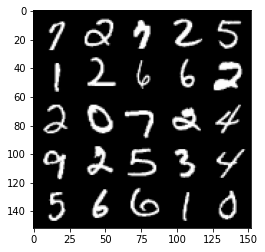

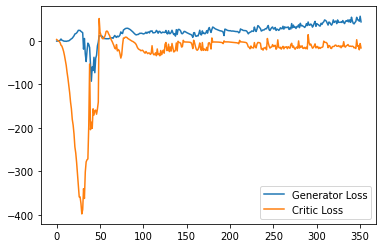

Step 7100: Generator loss: 43.797357635498045, critic loss: -15.456264531135554


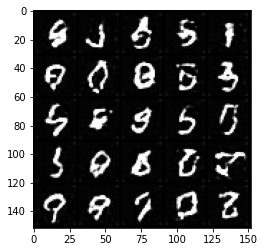

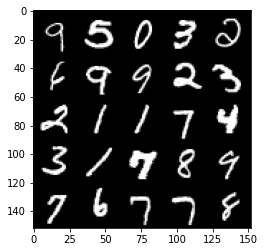

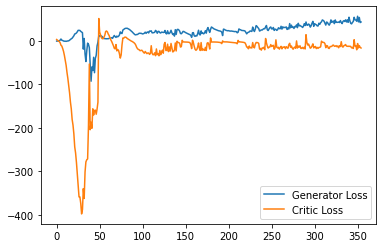

Step 7150: Generator loss: 49.857019653320314, critic loss: -12.867074499130249


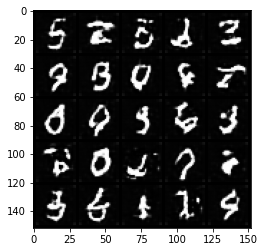

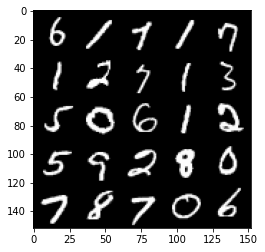

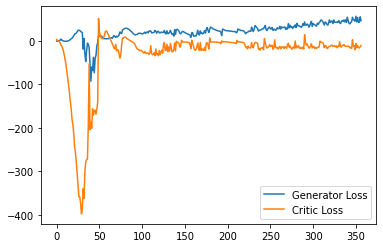

Step 7200: Generator loss: 47.570153884887695, critic loss: -16.232345569133763


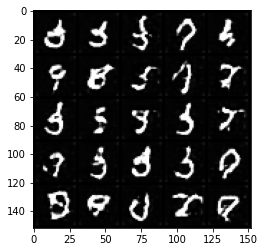

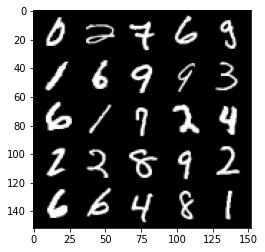

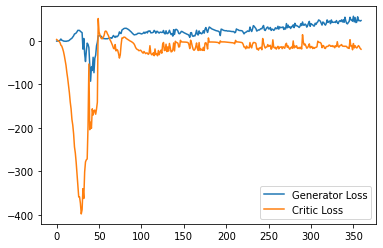

Step 7250: Generator loss: 52.728122329711915, critic loss: -9.357136362075803


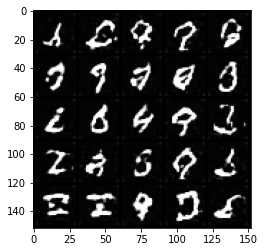

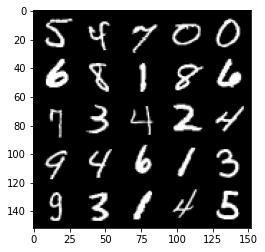

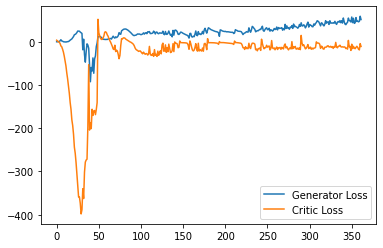

Step 7300: Generator loss: 53.43462417602539, critic loss: -12.396775788784028


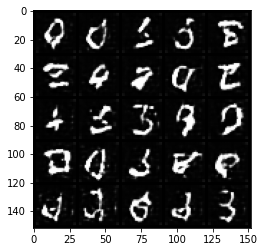

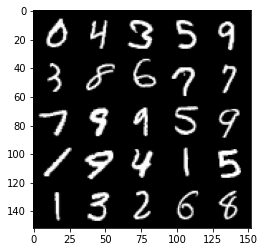

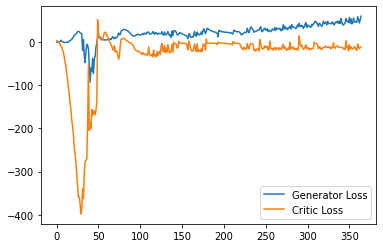

Step 7350: Generator loss: 44.08117046356201, critic loss: -17.029526356220245


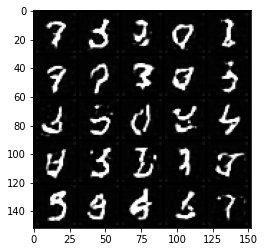

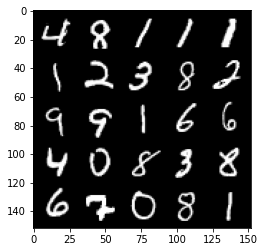

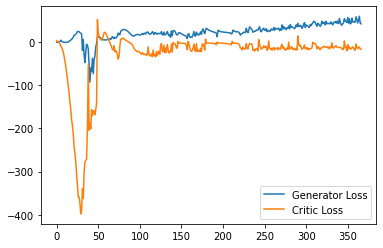

Step 7400: Generator loss: 49.917070922851565, critic loss: -15.272069931983946


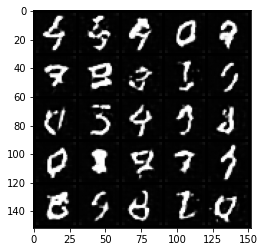

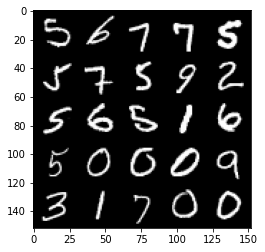

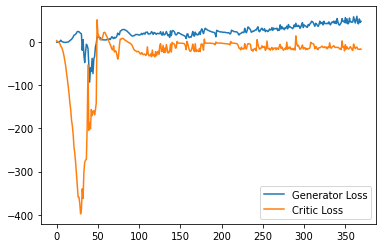

Step 7450: Generator loss: 47.111112899780274, critic loss: -14.91573641347885


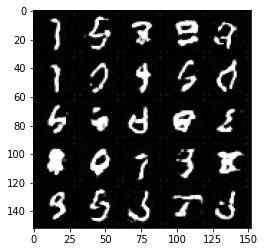

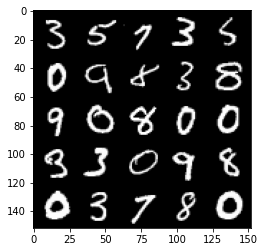

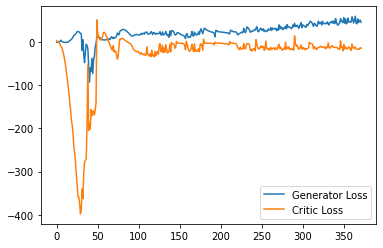

Step 7500: Generator loss: 46.38050590515137, critic loss: -17.97434047889709


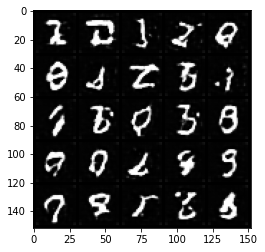

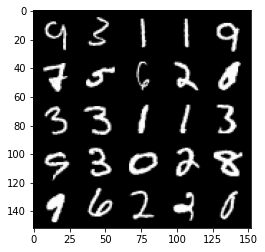

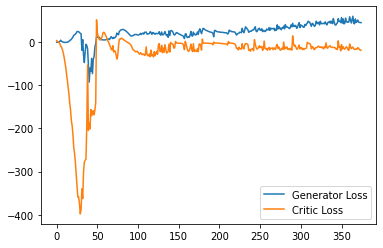

Step 7550: Generator loss: 53.2320970916748, critic loss: -4.071539816856382


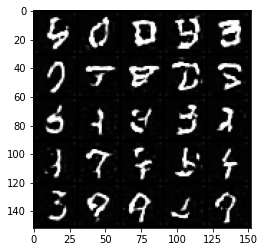

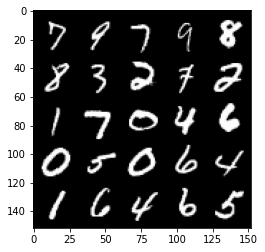

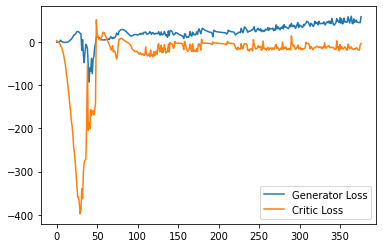

Step 7600: Generator loss: 53.58518295288086, critic loss: -11.965413311481475


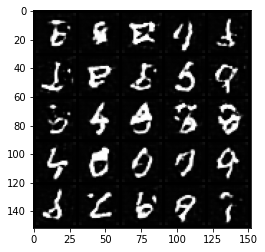

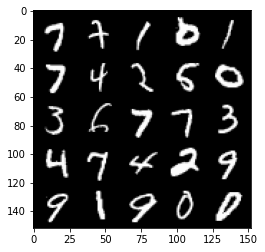

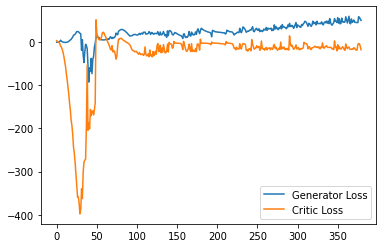

Step 7650: Generator loss: 56.58023452758789, critic loss: -10.893030299186703


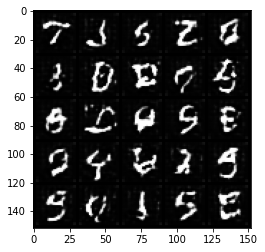

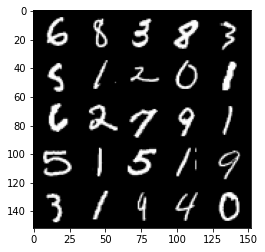

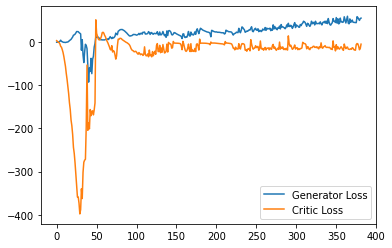

Step 7700: Generator loss: 48.59309326171875, critic loss: -18.662288296699515


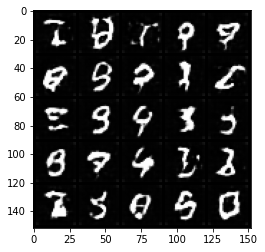

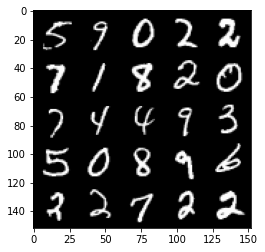

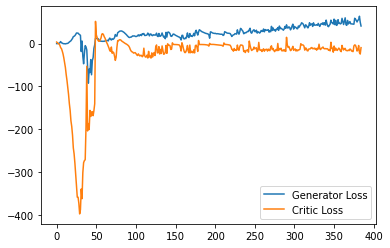

Step 7750: Generator loss: 43.23307708740234, critic loss: -10.423654558181763


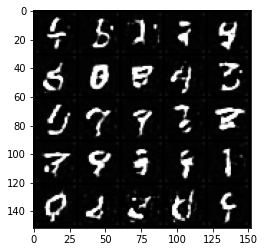

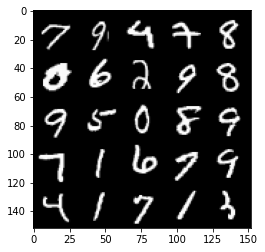

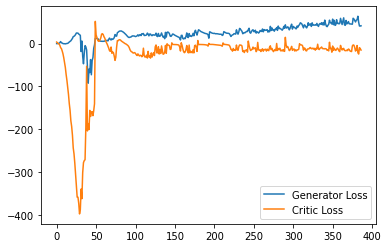

Step 7800: Generator loss: 46.50089668273926, critic loss: -10.108092372417447


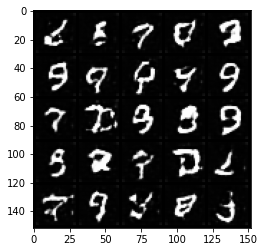

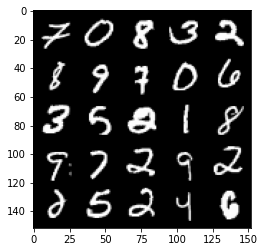

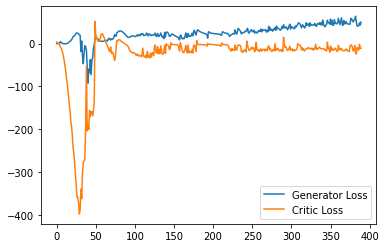

Step 7850: Generator loss: 47.276897201538084, critic loss: -14.452971606254573


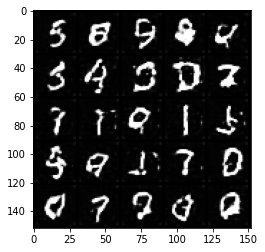

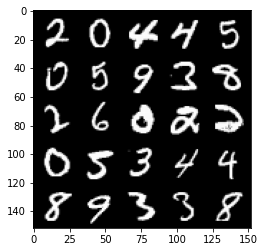

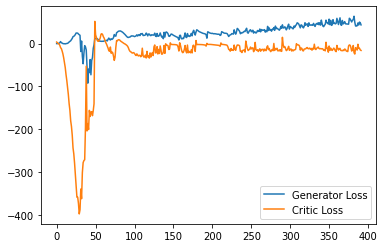

Step 7900: Generator loss: 50.87822944641113, critic loss: -12.664291481018067


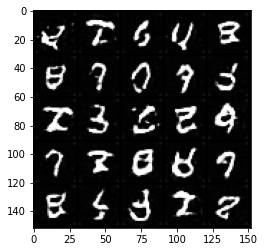

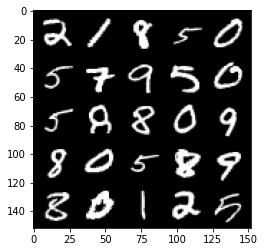

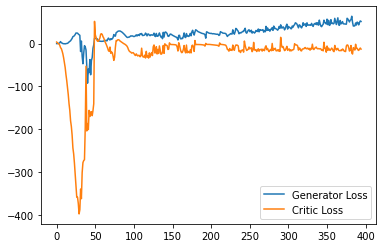

Step 7950: Generator loss: 50.04329437255859, critic loss: -11.915804325103764


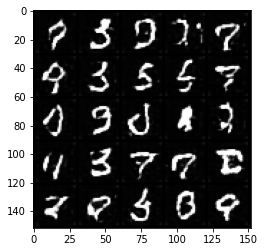

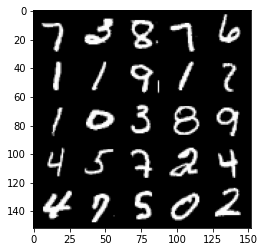

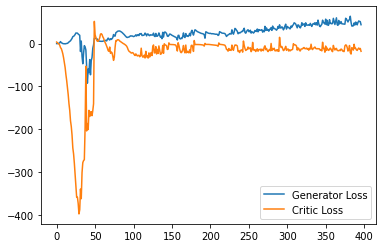

Step 8000: Generator loss: 51.88856285095215, critic loss: -12.109785295963286


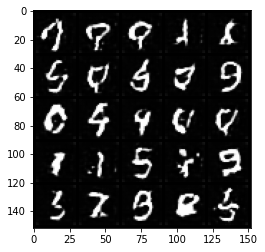

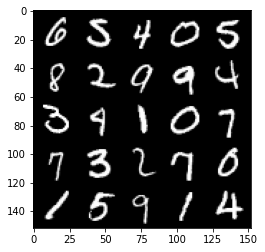

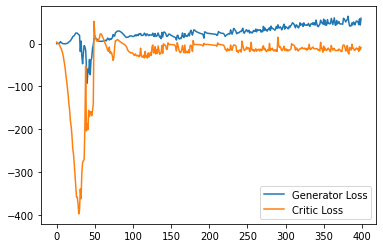

Step 8050: Generator loss: 47.150681800842285, critic loss: -16.59374722766876


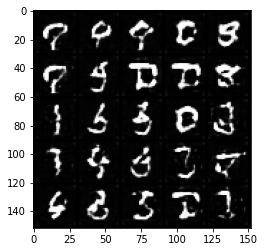

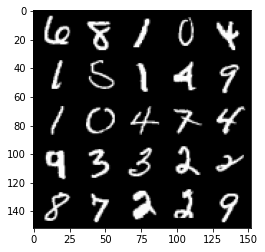

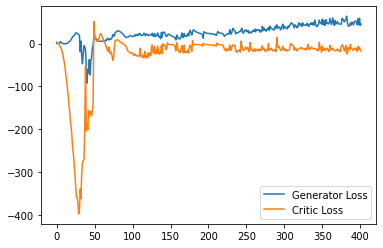

Step 8100: Generator loss: 43.722349319458004, critic loss: -11.523980514049528


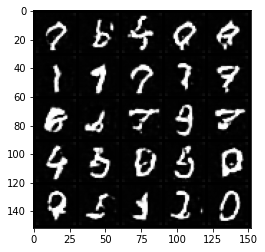

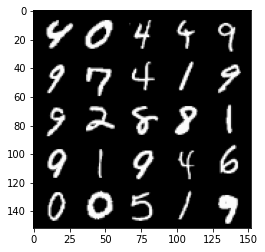

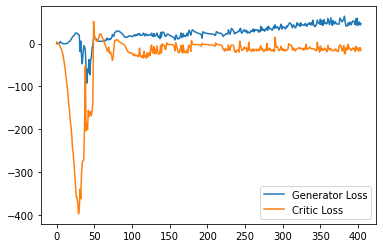

Step 8150: Generator loss: 54.14024070739746, critic loss: -10.680213854789736


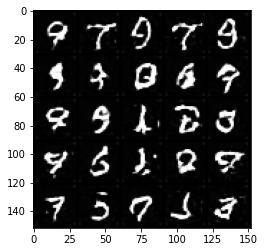

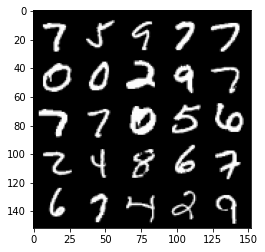

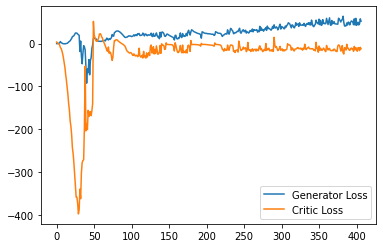

Step 8200: Generator loss: 55.202089385986326, critic loss: -10.922468097686766


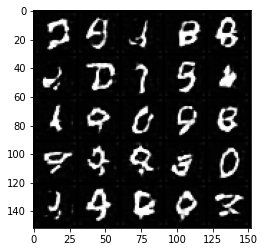

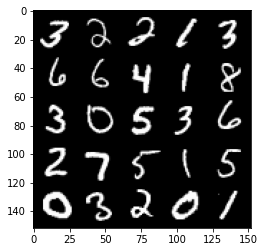

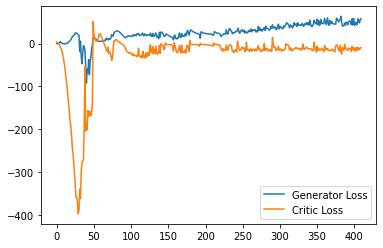

Step 8250: Generator loss: 49.8352645111084, critic loss: -4.54352163887024


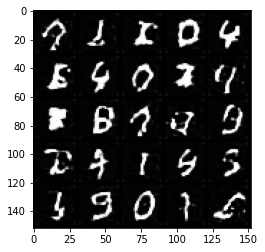

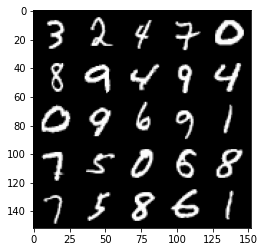

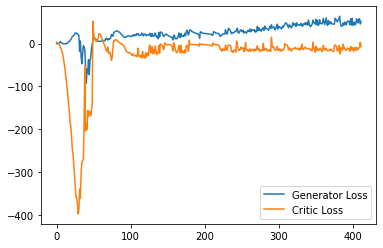

Step 8300: Generator loss: 50.5605583190918, critic loss: -15.269780157089233


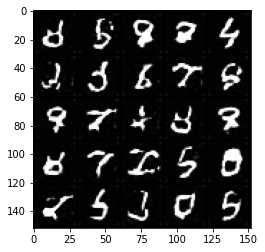

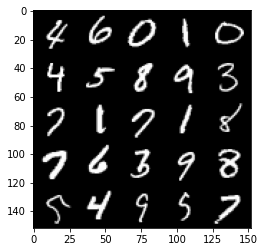

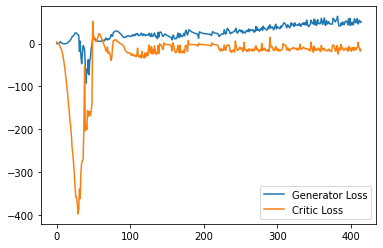

Step 8350: Generator loss: 50.09823432922363, critic loss: -13.22809630584717


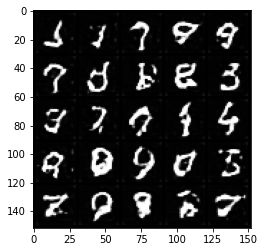

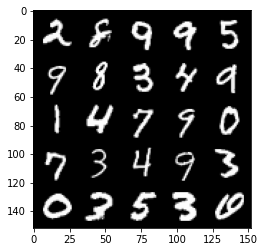

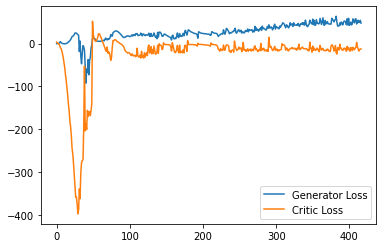

Step 8400: Generator loss: 49.776997299194335, critic loss: -15.497138734817504


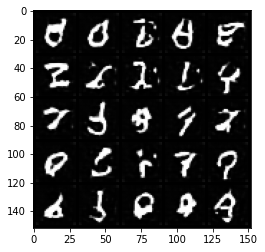

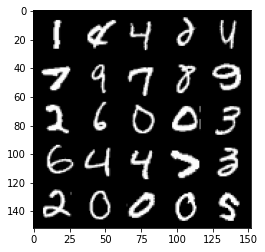

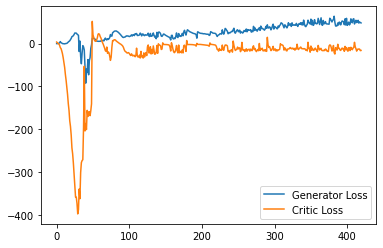

Step 8450: Generator loss: 54.106029739379885, critic loss: -15.042142205715182


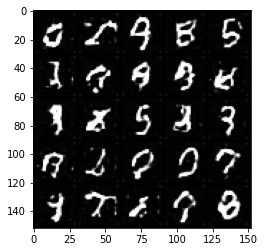

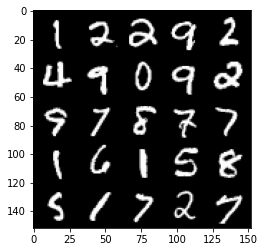

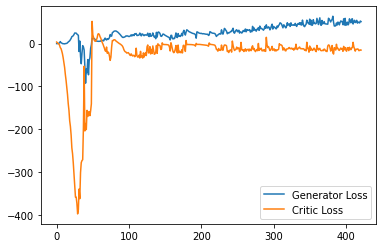

Step 8500: Generator loss: 53.848270111083984, critic loss: -6.435319952487943


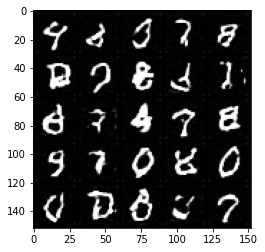

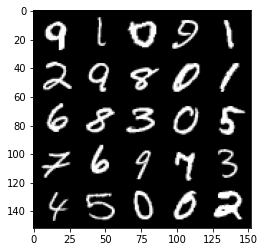

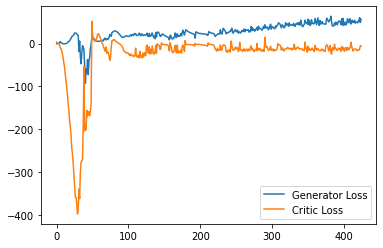

Step 8550: Generator loss: 54.559363174438474, critic loss: -10.200616624593735


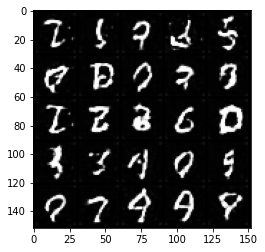

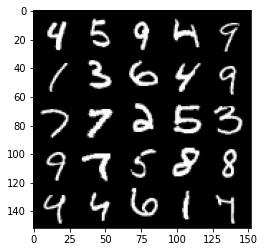

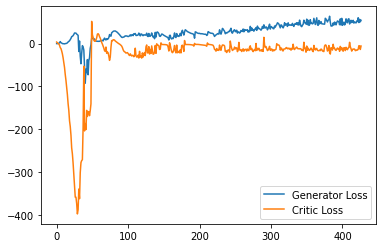

Step 8600: Generator loss: 46.31489906311035, critic loss: -12.897017914295196


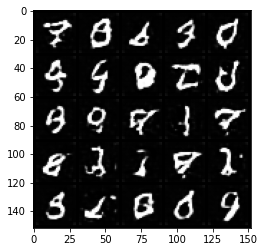

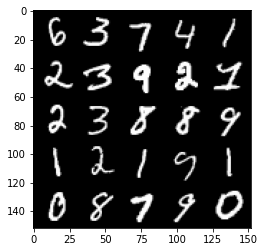

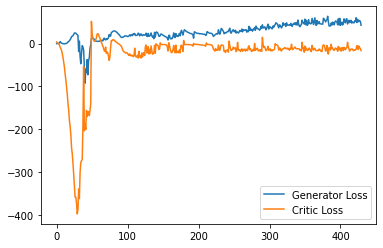

Step 8650: Generator loss: 49.14724197387695, critic loss: -15.207704356431961


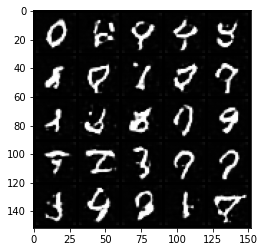

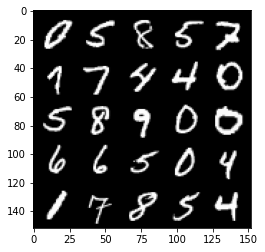

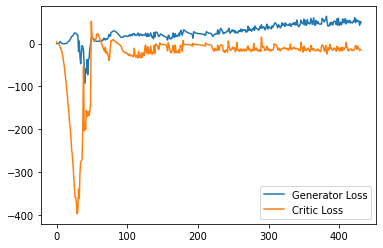

Step 8700: Generator loss: 48.572447814941405, critic loss: -18.156497407436376


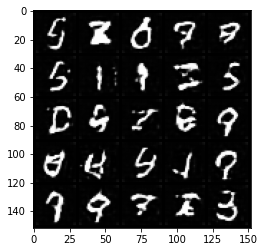

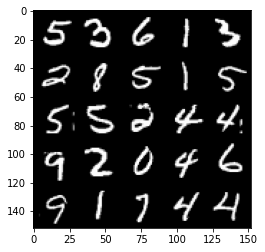

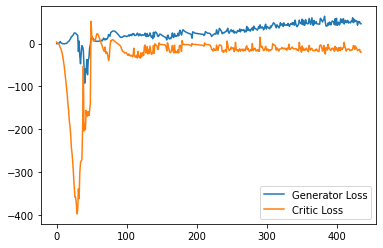

Step 8750: Generator loss: 50.878778533935545, critic loss: -15.937889003753655


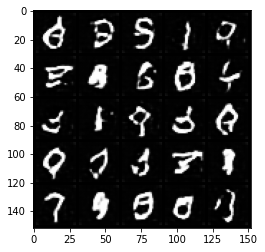

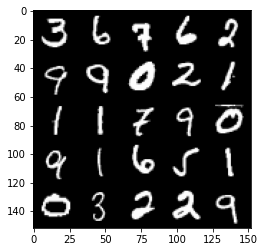

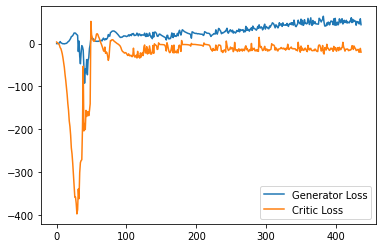

Step 8800: Generator loss: 50.969644470214845, critic loss: -11.306682799816134


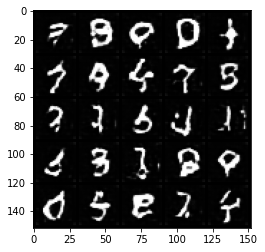

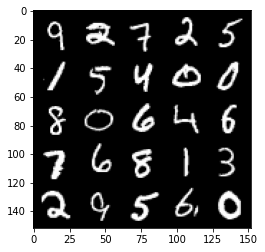

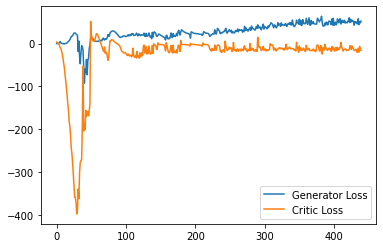

Step 8850: Generator loss: 52.18570663452149, critic loss: -14.194954086303715


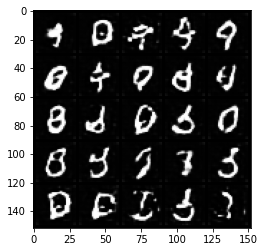

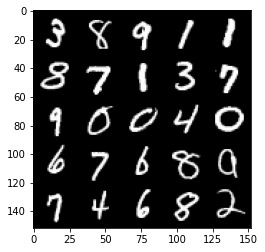

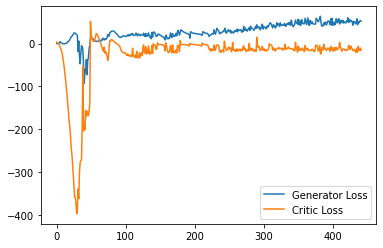

Step 8900: Generator loss: 56.33258972167969, critic loss: -10.909883960247042


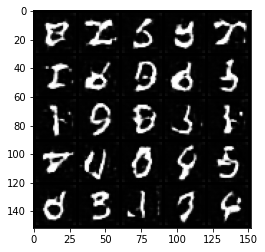

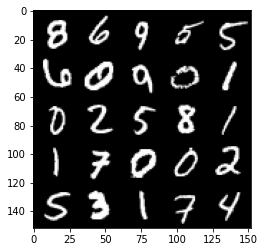

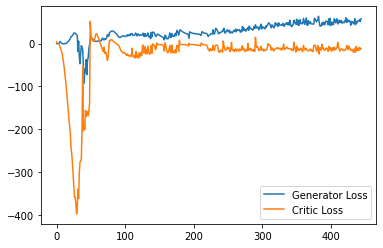

Step 8950: Generator loss: 49.82899490356445, critic loss: -15.590479827880861


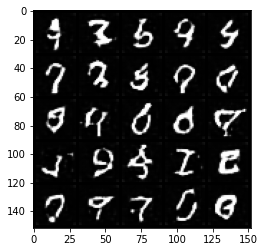

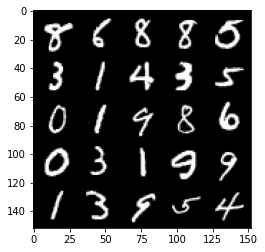

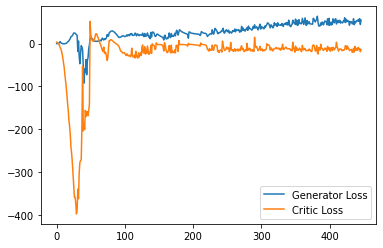

Step 9000: Generator loss: 52.136318092346194, critic loss: -14.457772207260131


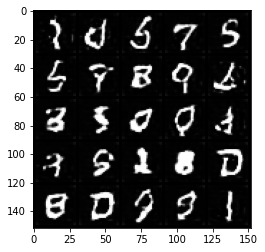

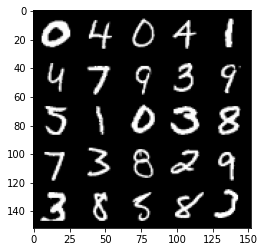

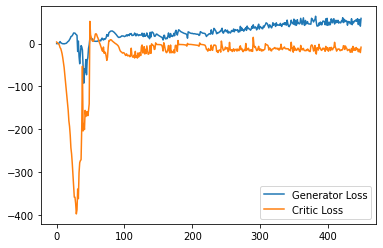

Step 9050: Generator loss: 49.59854789733887, critic loss: -16.62230380153656


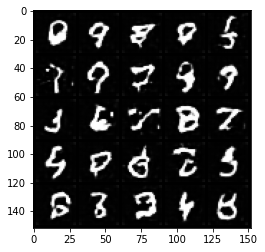

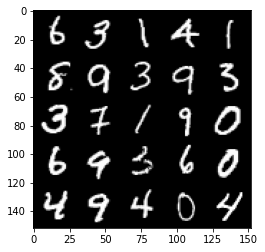

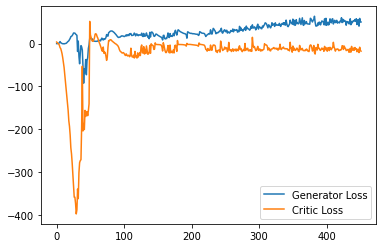

Step 9100: Generator loss: 50.16184776306152, critic loss: -3.120431458115577


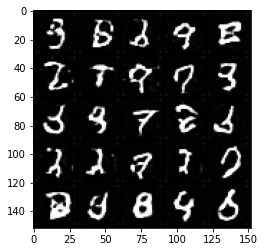

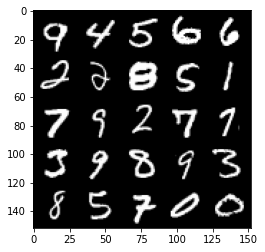

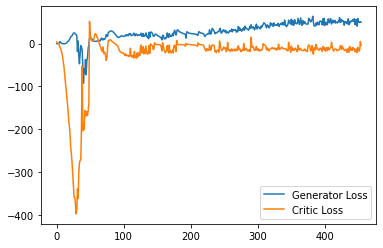

Step 9150: Generator loss: 52.04070816040039, critic loss: -10.020551839351654


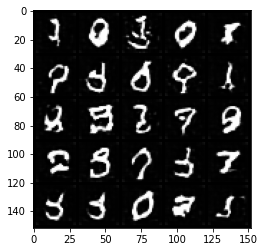

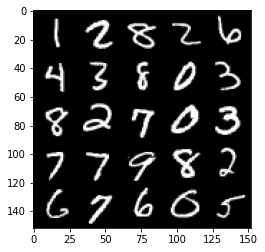

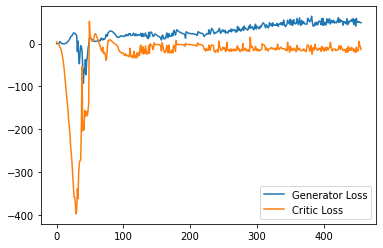

Step 9200: Generator loss: 53.54780387878418, critic loss: -16.66471493291855


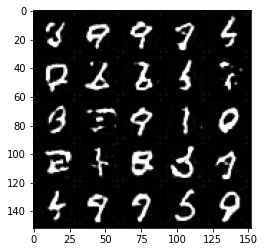

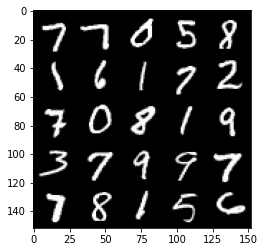

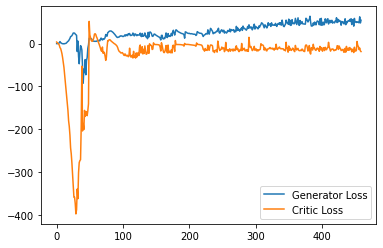

Step 9250: Generator loss: 56.21752166748047, critic loss: -13.827622148990633


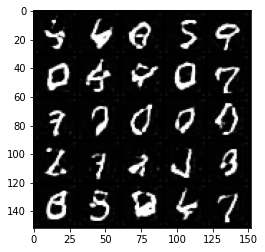

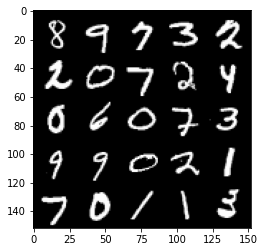

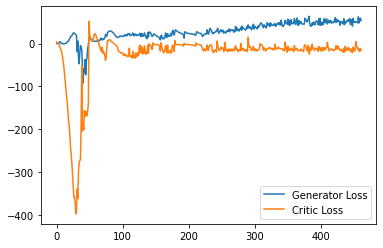

Step 9300: Generator loss: 53.288301391601564, critic loss: -16.56217481613159


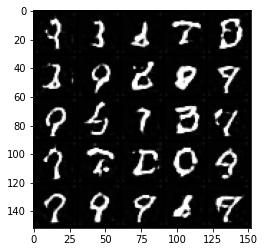

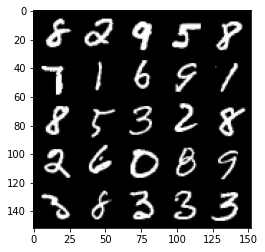

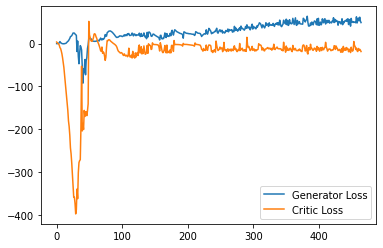

Step 9350: Generator loss: 51.009227142333984, critic loss: -17.500204399585726


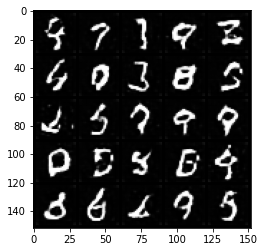

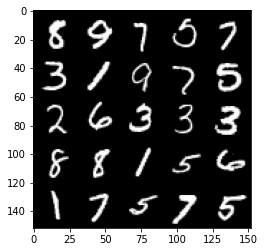

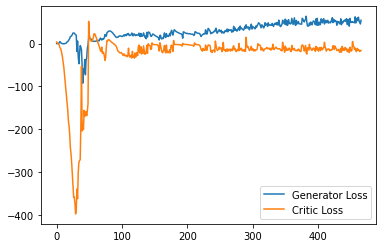

Step 9400: Generator loss: 58.608737258911134, critic loss: -3.70065786933899


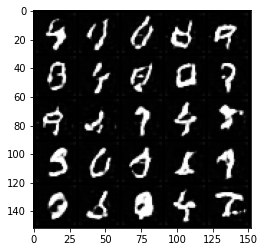

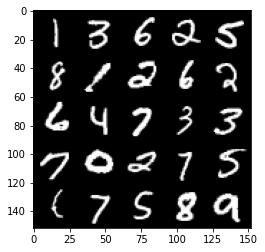

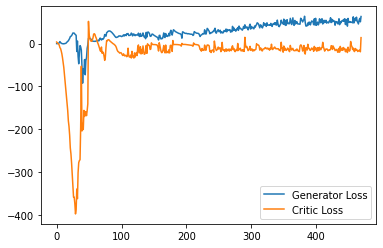

Step 9450: Generator loss: 55.28250549316406, critic loss: -8.426679892539976


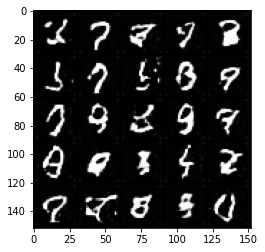

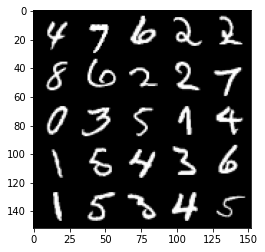

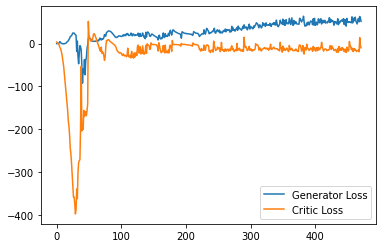

Step 9500: Generator loss: 50.08848350524902, critic loss: -15.964580813646315


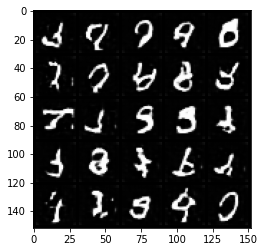

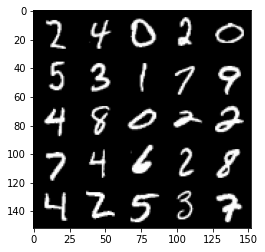

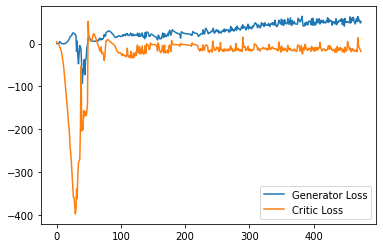

Step 9550: Generator loss: 59.12463874816895, critic loss: -11.870622364044188


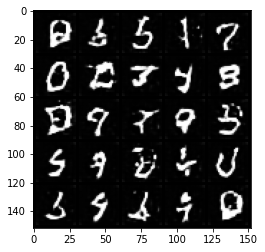

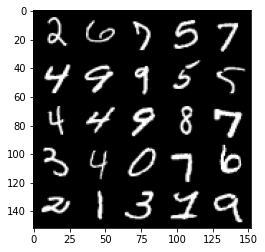

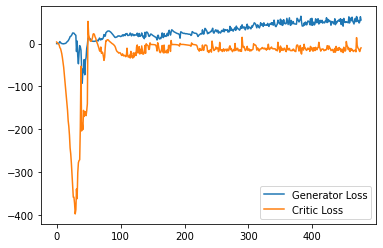

Step 9600: Generator loss: 54.263114852905275, critic loss: -13.64801845264435


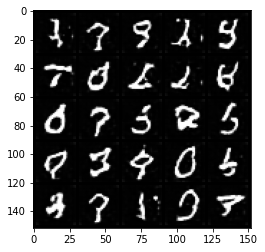

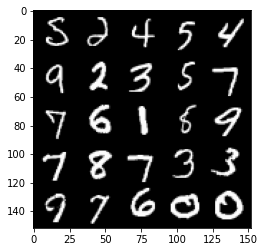

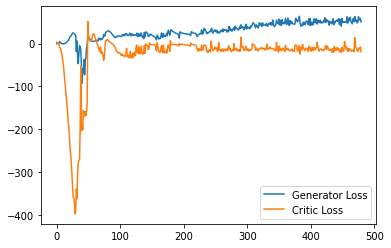

Step 9650: Generator loss: 57.829231338500975, critic loss: -12.465796841144563


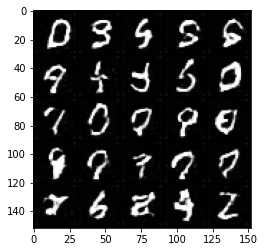

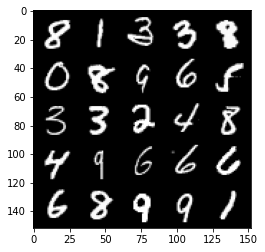

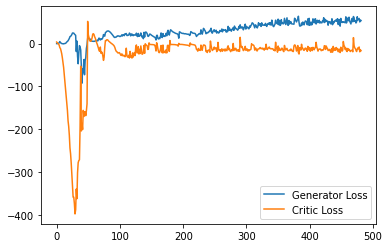

Step 9700: Generator loss: 54.1288793182373, critic loss: -10.240009448051453


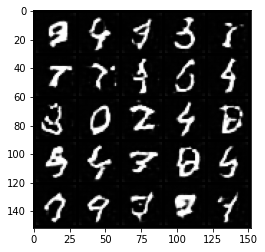

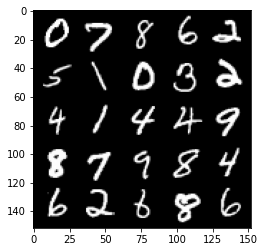

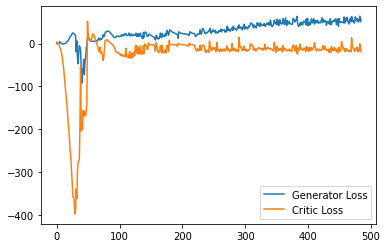

Step 9750: Generator loss: 57.099896926879886, critic loss: -12.531727615118028


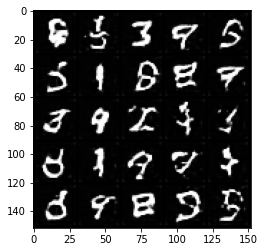

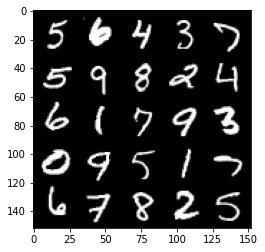

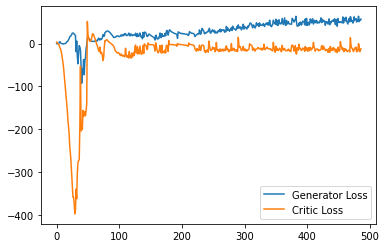

Step 9800: Generator loss: 58.293626861572264, critic loss: -13.758320850372312


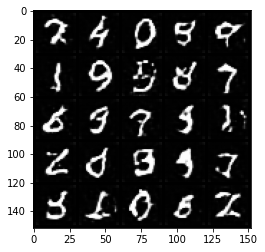

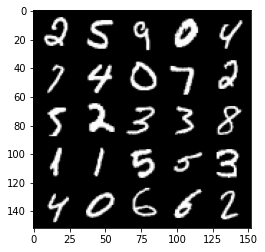

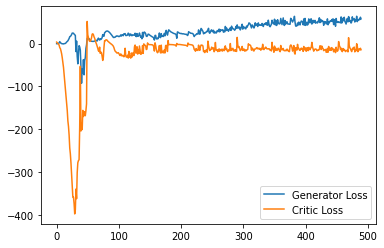

Step 9850: Generator loss: 55.48565055847168, critic loss: -7.722169265747071


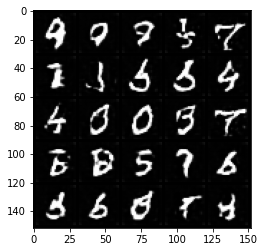

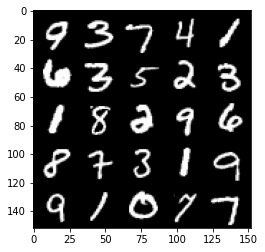

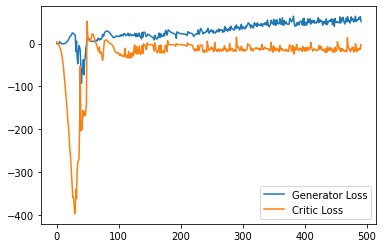

Step 9900: Generator loss: 51.987921981811525, critic loss: -17.722205958366395


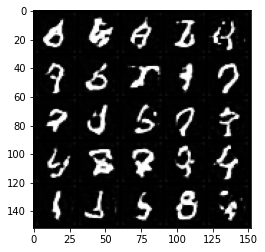

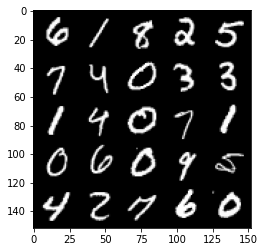

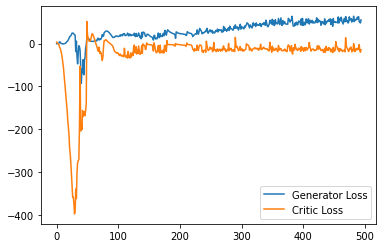

Step 9950: Generator loss: 60.627720489501954, critic loss: -13.396880905151365


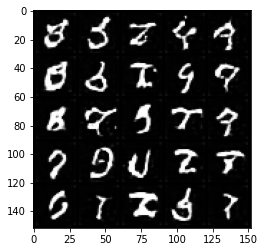

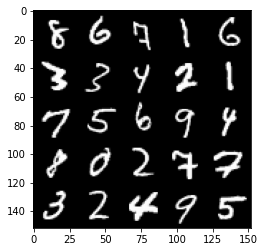

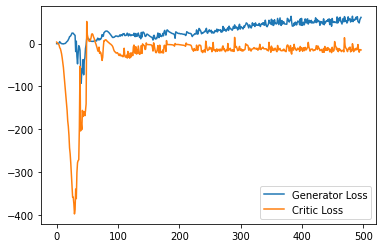

Step 10000: Generator loss: 52.7332071685791, critic loss: -15.90681073999405


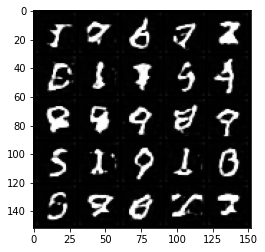

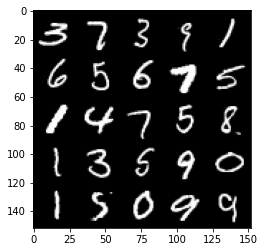

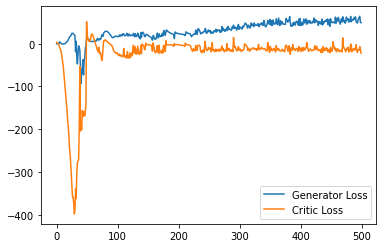

Step 10050: Generator loss: 61.559950256347655, critic loss: -11.700200176239013


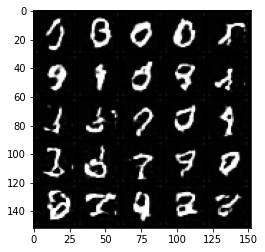

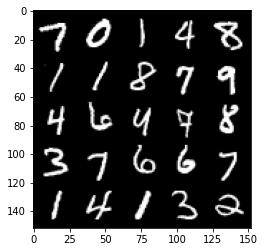

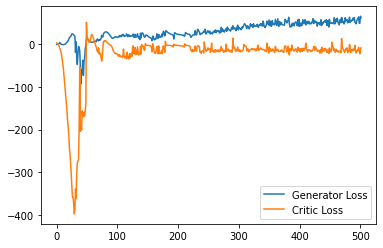

Step 10100: Generator loss: 53.67227996826172, critic loss: -17.246635929584503


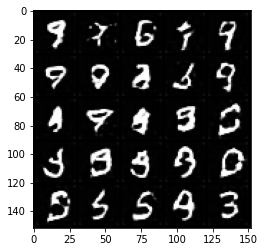

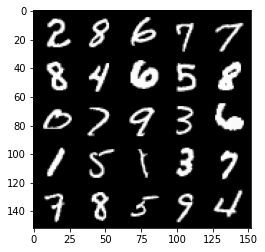

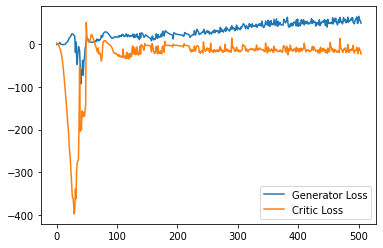

Step 10150: Generator loss: 60.09964317321777, critic loss: -15.240574462890624


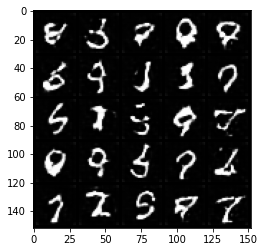

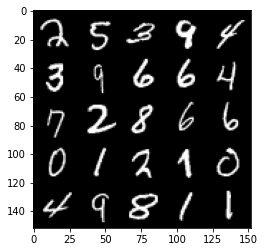

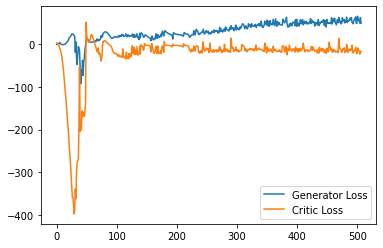

Step 10200: Generator loss: 58.84233474731445, critic loss: -13.387796381950382


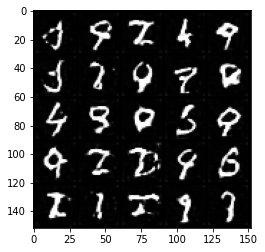

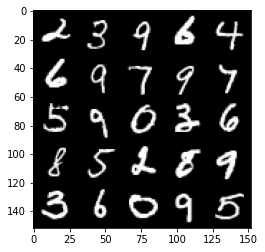

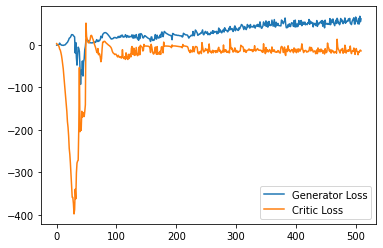

Step 10250: Generator loss: 54.612091903686526, critic loss: -18.743308454990384


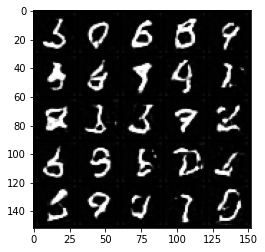

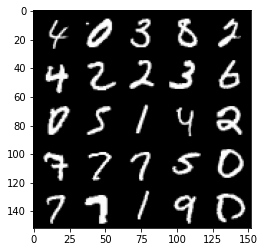

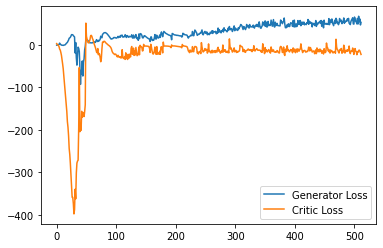

Step 10300: Generator loss: 57.050388221740725, critic loss: -15.587986067295075


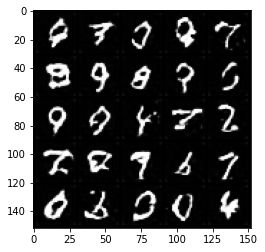

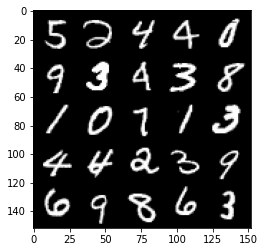

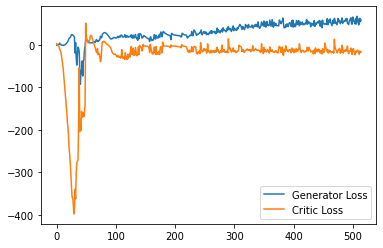

Step 10350: Generator loss: 59.417901763916014, critic loss: -13.243708336830133


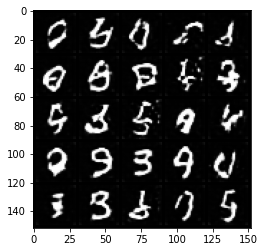

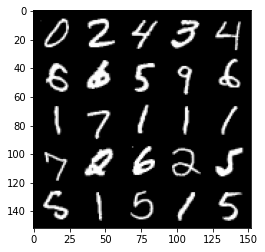

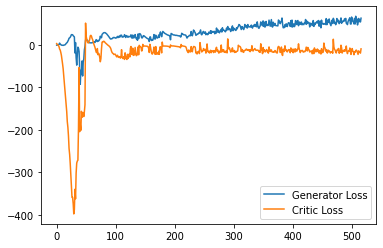

Step 10400: Generator loss: 57.41633430480957, critic loss: -15.89345171022415


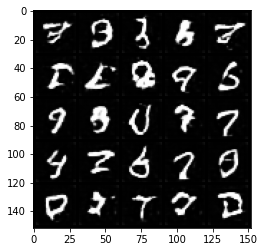

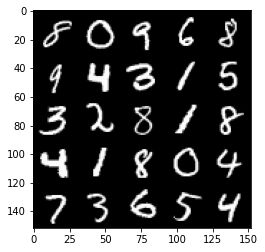

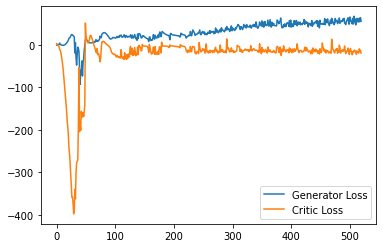

Step 10450: Generator loss: 60.50889389038086, critic loss: -9.854825208187105


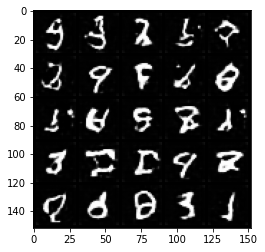

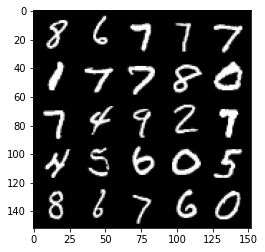

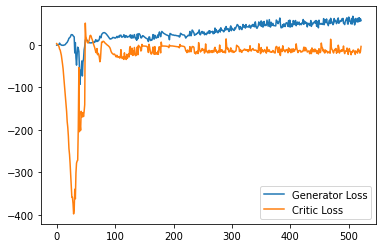

Step 10500: Generator loss: 53.47280395507813, critic loss: -17.67114971160889


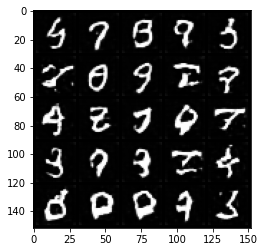

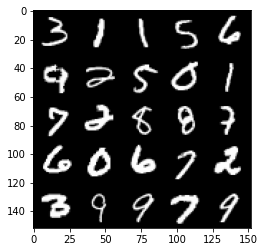

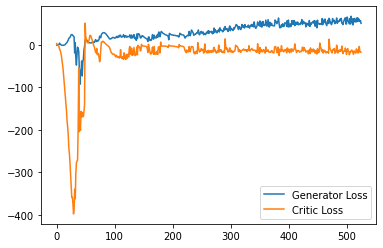

Step 10550: Generator loss: 57.960227432250974, critic loss: -14.321765673637392


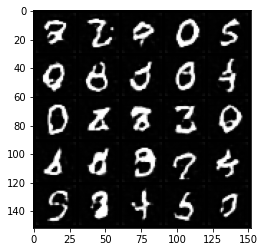

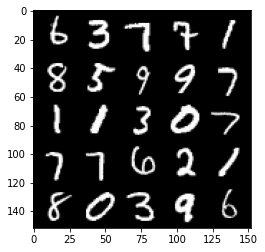

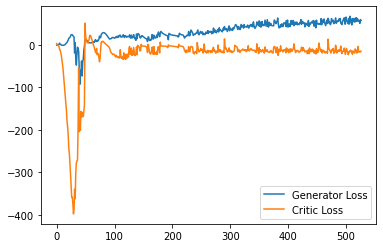

Step 10600: Generator loss: 61.295105361938475, critic loss: -10.515780969619748


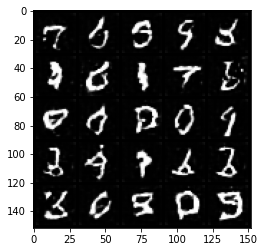

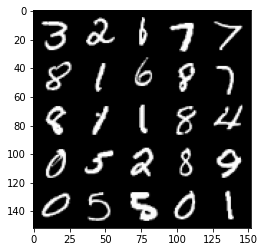

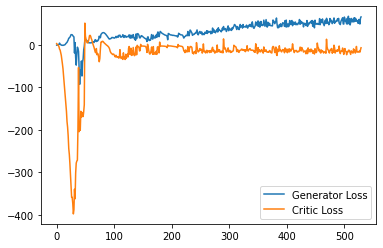

Step 10650: Generator loss: 58.13522201538086, critic loss: -14.858545324325561


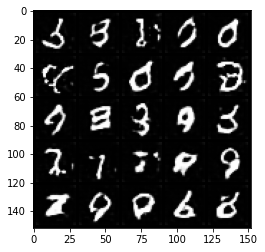

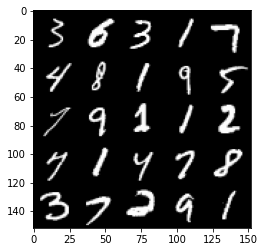

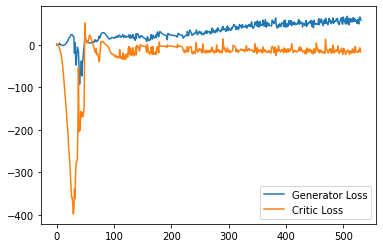

Step 10700: Generator loss: 50.893755416870114, critic loss: -18.97924815464019


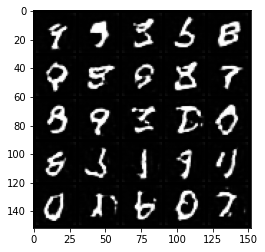

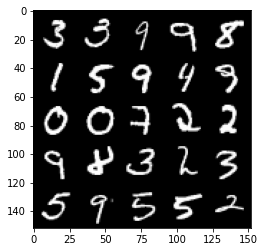

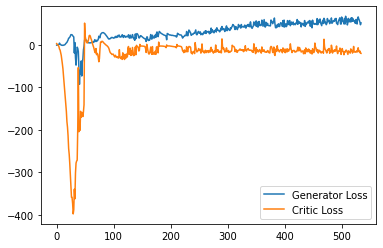

Step 10750: Generator loss: 59.4428751373291, critic loss: -14.102940680742268


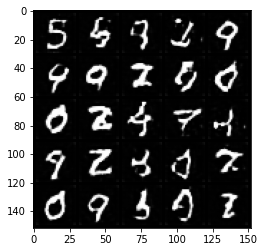

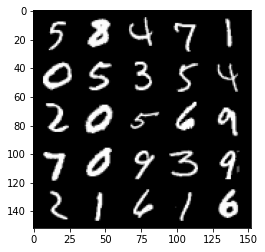

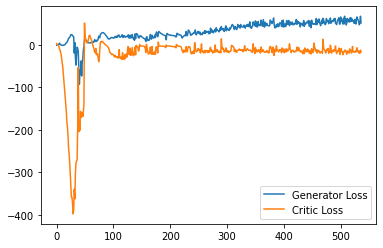

Step 10800: Generator loss: 54.61606269836426, critic loss: -15.936845652580262


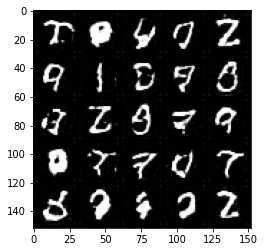

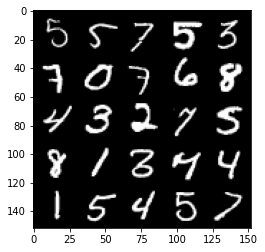

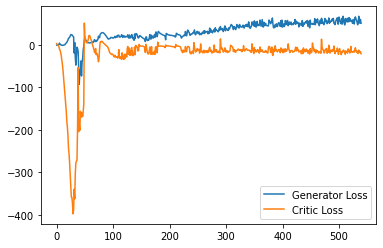

Step 10850: Generator loss: 56.383329467773436, critic loss: -15.34117355346679


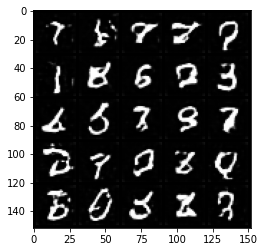

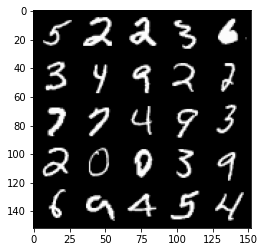

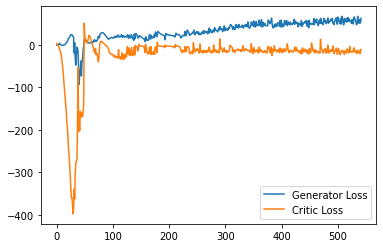

Step 10900: Generator loss: 54.1268883895874, critic loss: -20.44568786621094


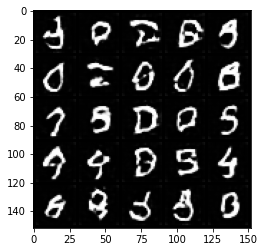

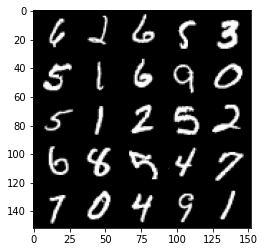

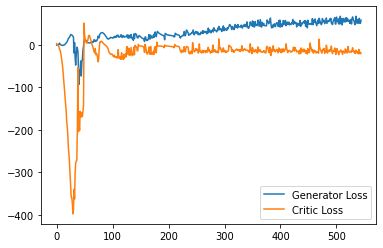

Step 10950: Generator loss: 52.65058647155762, critic loss: -20.610380735874177


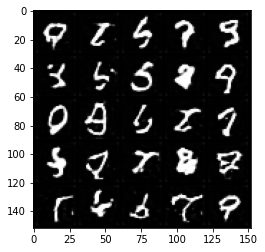

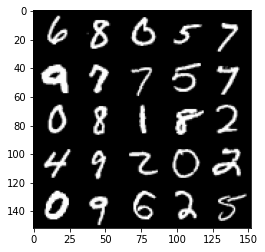

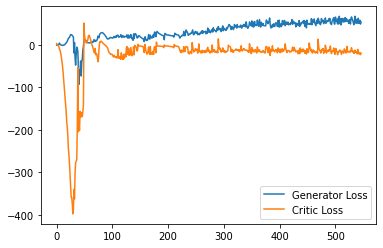

Step 11000: Generator loss: 68.5097110748291, critic loss: -13.744984811782833


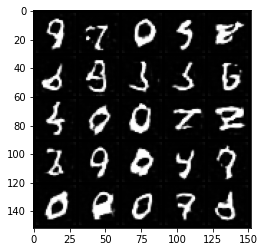

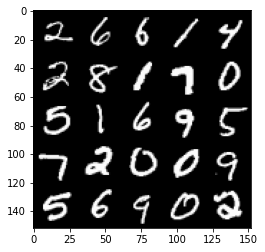

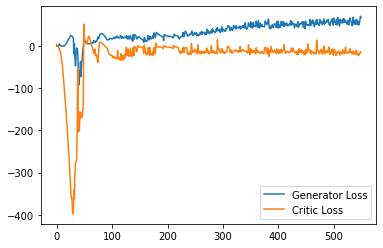

Step 11050: Generator loss: 58.68904472351074, critic loss: -13.695235739707948


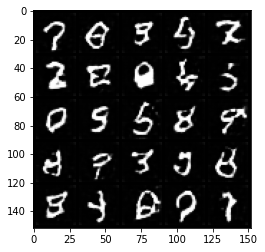

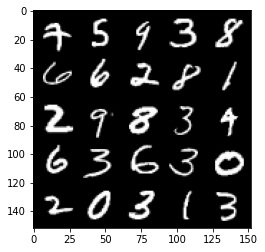

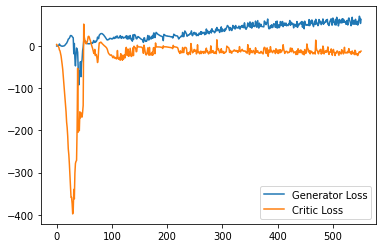

Step 11100: Generator loss: 61.22278022766113, critic loss: -13.35983989238739


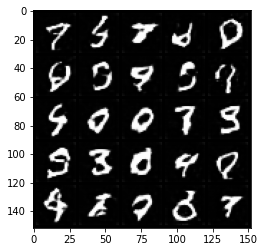

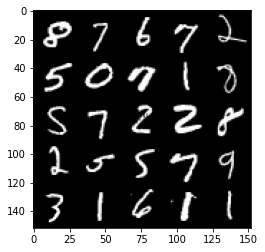

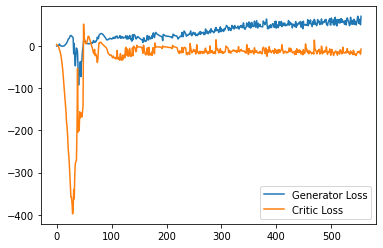

Step 11150: Generator loss: 62.23626846313476, critic loss: -12.298100755453108


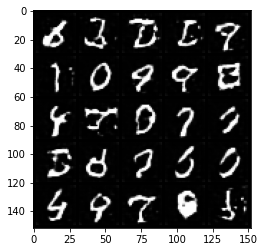

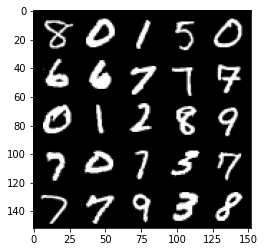

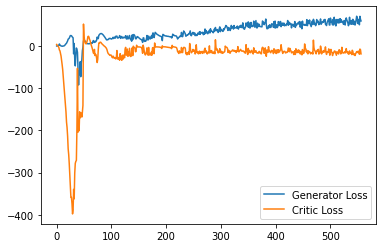

Step 11200: Generator loss: 58.62557395935059, critic loss: -13.916800900936126


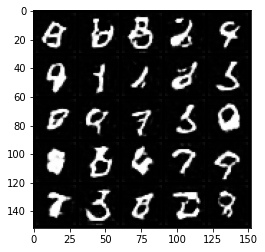

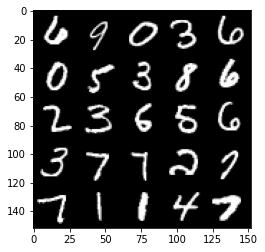

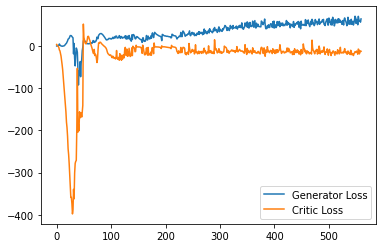

Step 11250: Generator loss: 58.532891845703126, critic loss: -12.985928770542143


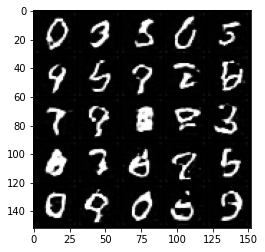

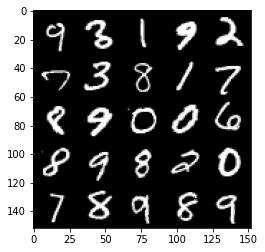

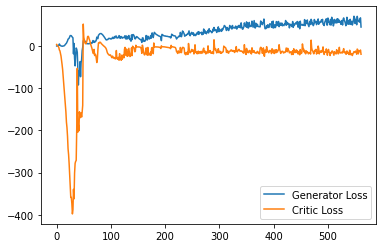

Step 11300: Generator loss: 58.12695449829101, critic loss: -10.511488230228421


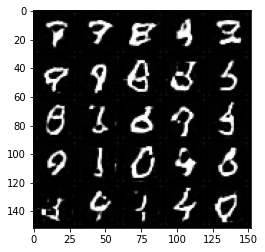

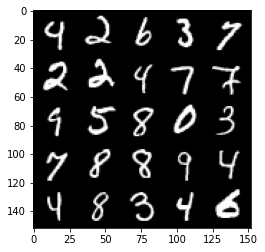

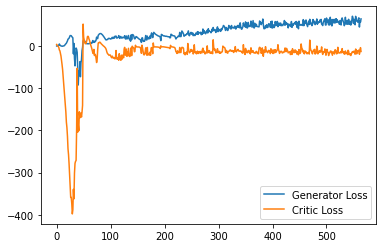

Step 11350: Generator loss: 62.28342178344727, critic loss: -14.149138326406483


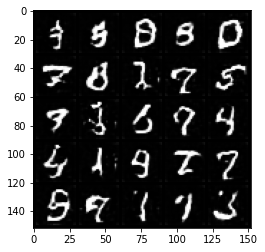

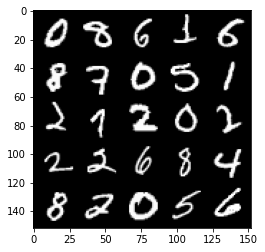

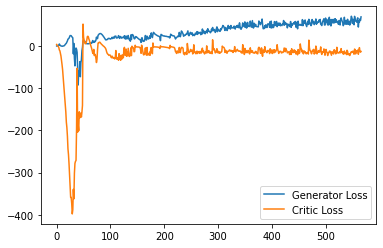

Step 11400: Generator loss: 56.47590103149414, critic loss: -17.696500488758087


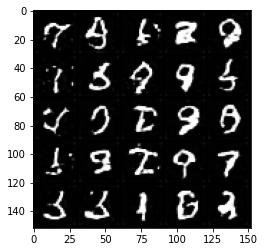

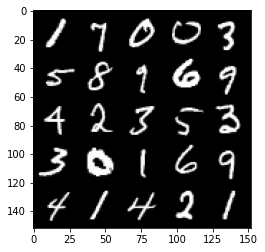

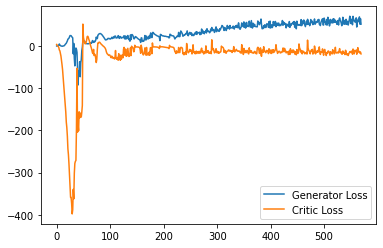

Step 11450: Generator loss: 61.79531394958496, critic loss: -18.129600777626038


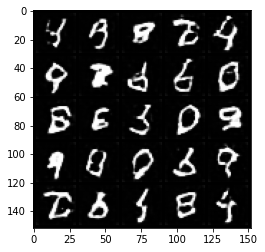

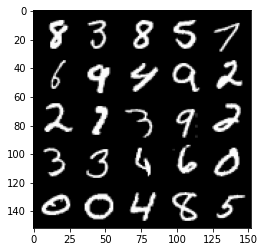

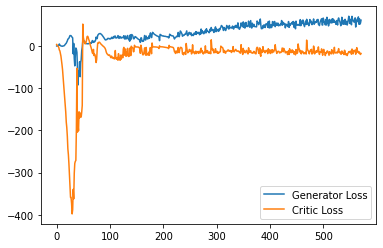

Step 11500: Generator loss: 61.77063301086426, critic loss: -11.06528653383255


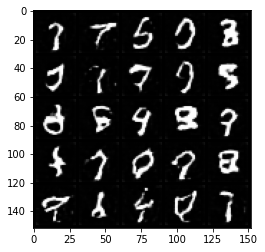

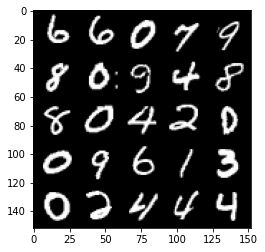

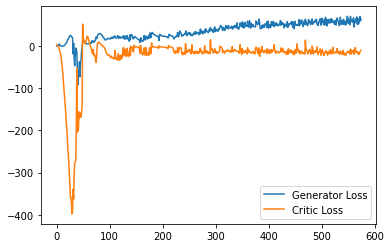

Step 11550: Generator loss: 62.78653251647949, critic loss: -11.421023339271539


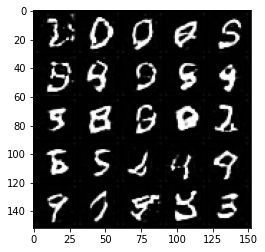

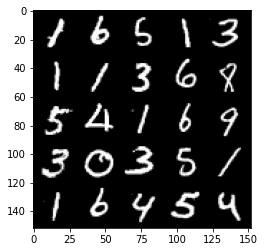

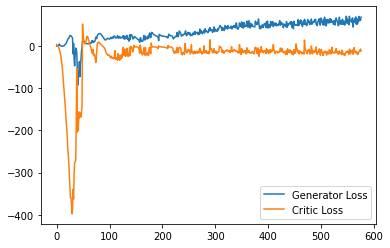

Step 11600: Generator loss: 66.24820983886718, critic loss: -12.834178298950192


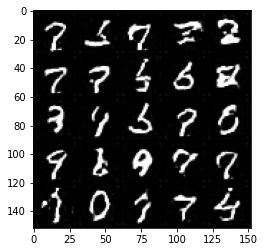

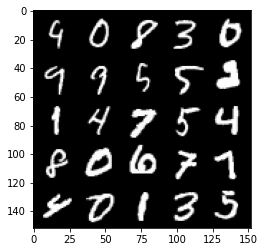

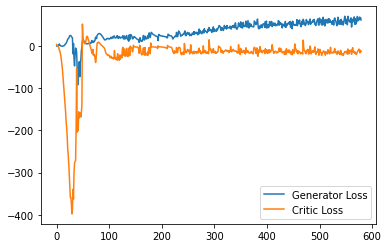

Step 11650: Generator loss: 56.94281242370605, critic loss: -22.0495360776186


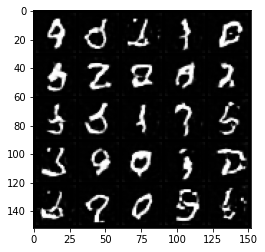

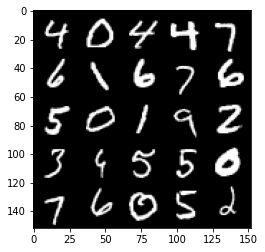

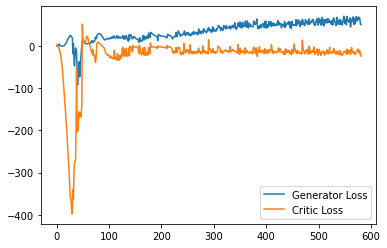

Step 11700: Generator loss: 58.157050399780275, critic loss: -13.679401096105575


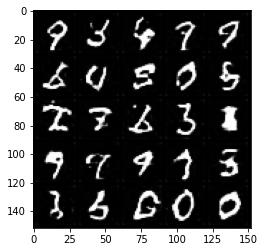

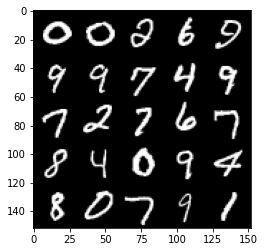

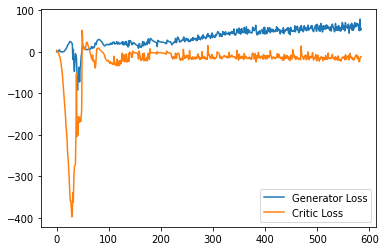

Step 11750: Generator loss: 57.97994247436523, critic loss: -17.66676209449768


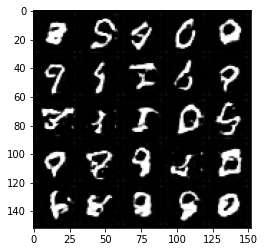

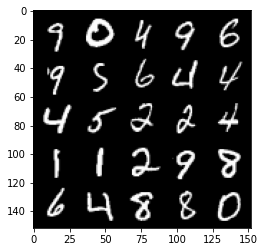

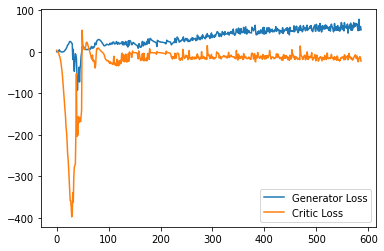

Step 11800: Generator loss: 66.44831733703613, critic loss: -10.982464216470719


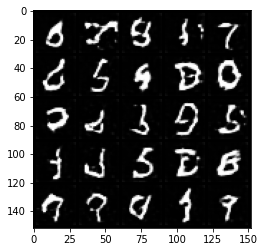

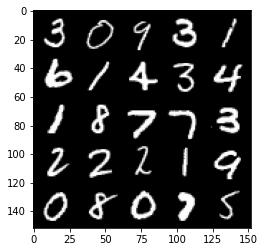

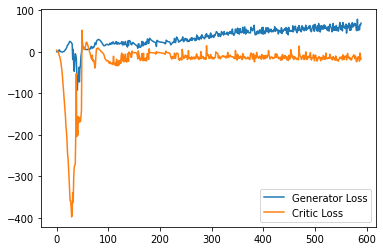

Step 11850: Generator loss: 65.05224822998046, critic loss: -15.1551377863884


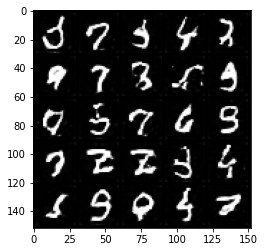

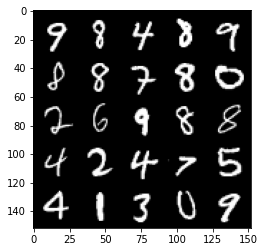

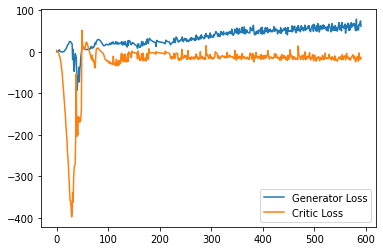

Step 11900: Generator loss: 53.15039802551269, critic loss: -21.775723501682283


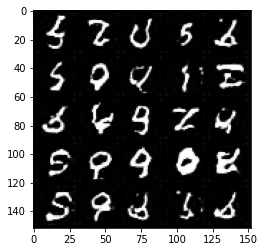

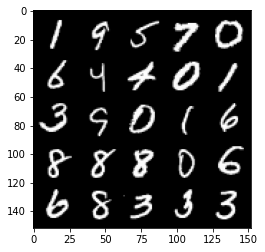

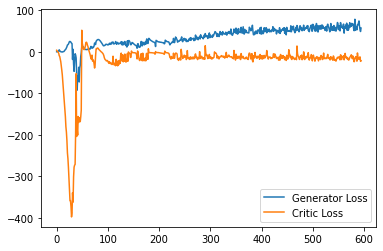

Step 11950: Generator loss: 63.67758636474609, critic loss: -16.62609089422226


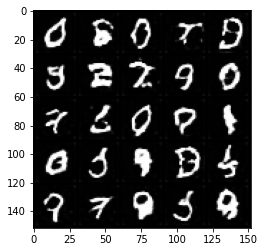

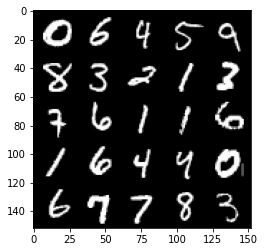

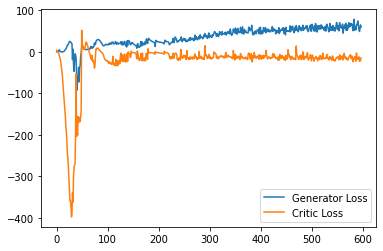

Step 12000: Generator loss: 69.74201171875, critic loss: -14.47361128163338


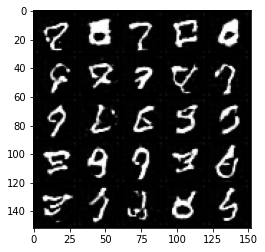

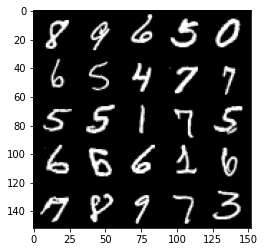

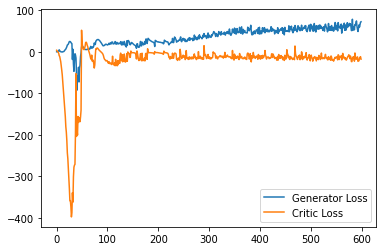

Step 12050: Generator loss: 63.73112121582031, critic loss: -15.951011184692376


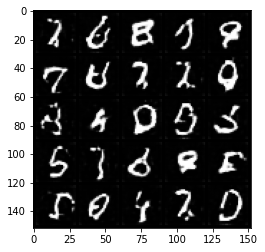

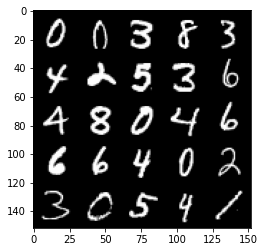

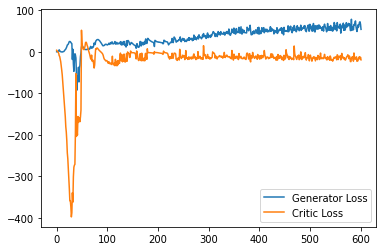

Step 12100: Generator loss: 64.29548583984375, critic loss: -12.105550144195556


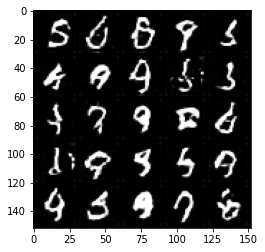

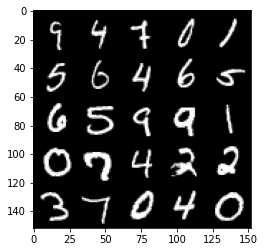

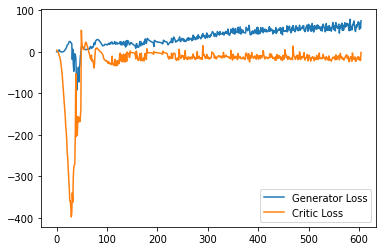

Step 12150: Generator loss: 62.220067749023436, critic loss: -11.251536476612092


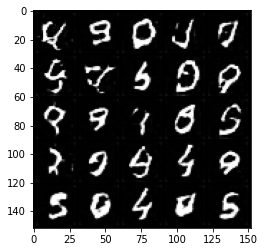

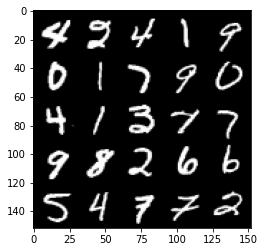

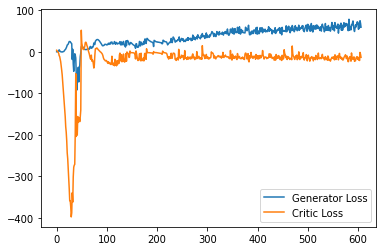

Step 12200: Generator loss: 64.82169845581055, critic loss: -17.1830260617733


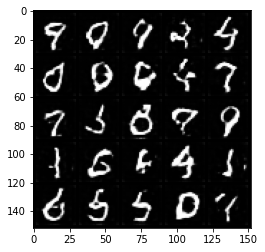

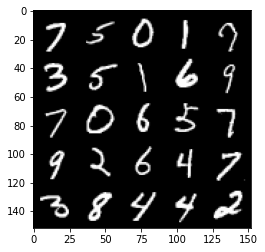

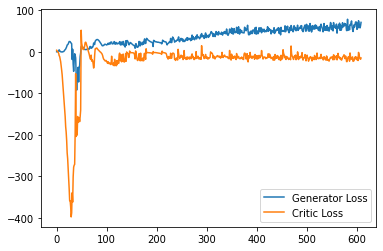

Step 12250: Generator loss: 56.389777450561525, critic loss: -17.457681186199185


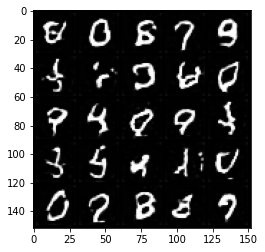

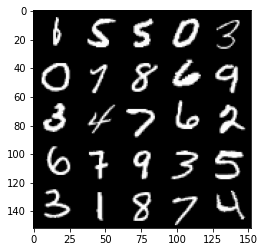

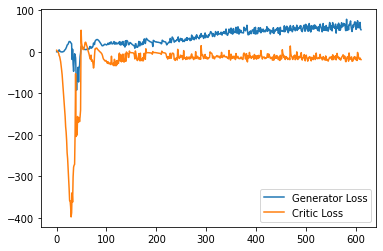

Step 12300: Generator loss: 63.4255672454834, critic loss: -18.19580600595474


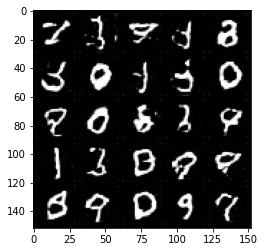

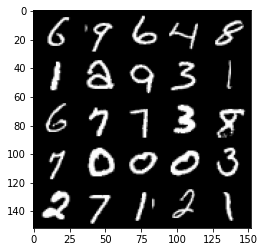

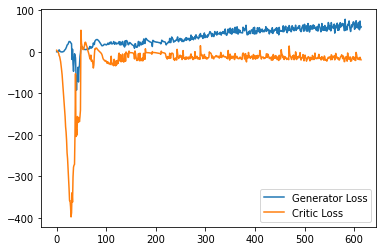

Step 12350: Generator loss: 64.81495346069336, critic loss: -15.490891122341157


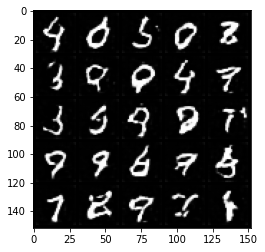

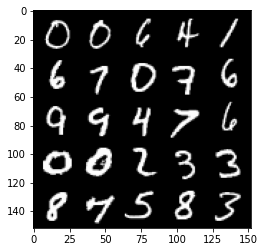

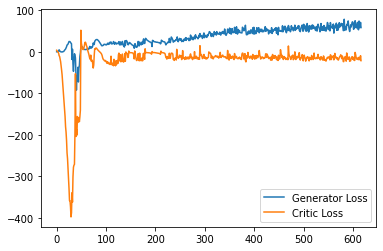

Step 12400: Generator loss: 68.17550071716309, critic loss: -17.07500545549393


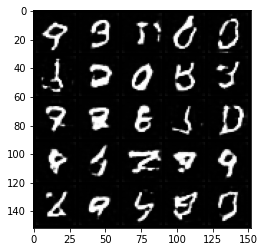

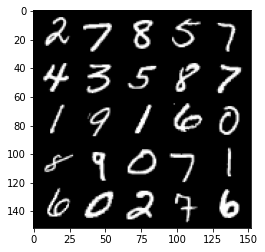

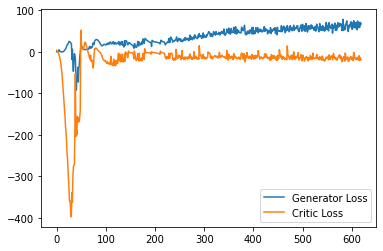

Step 12450: Generator loss: 67.07431957244873, critic loss: -11.094015824794772


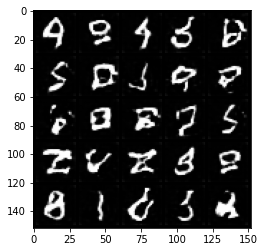

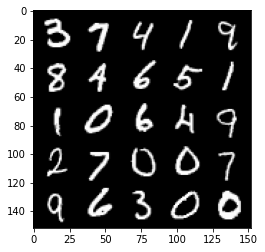

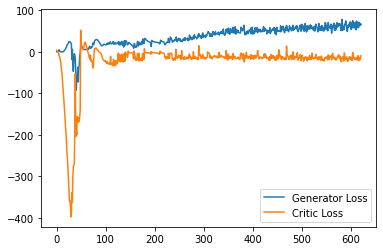

Step 12500: Generator loss: 68.41841934204102, critic loss: -12.062124686241152


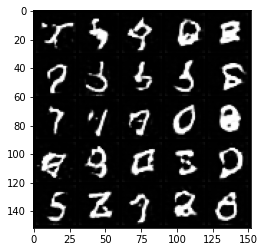

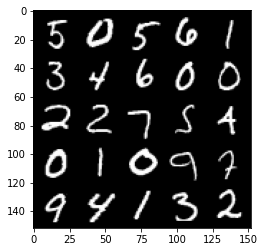

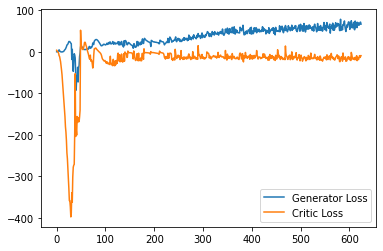

Step 12550: Generator loss: 67.96188110351562, critic loss: -10.953269685745243


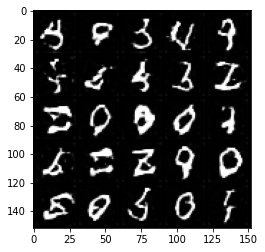

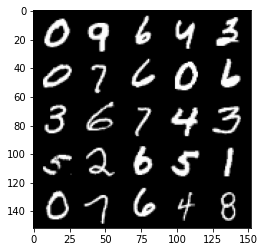

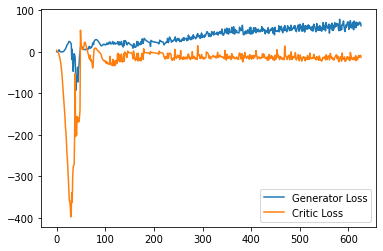

Step 12600: Generator loss: 58.379443321228024, critic loss: -17.711602684736253


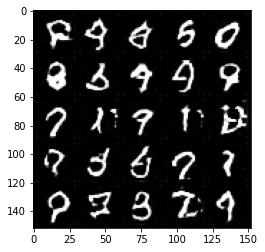

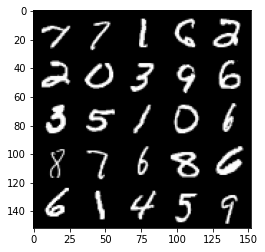

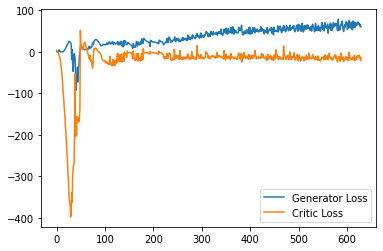

Step 12650: Generator loss: 66.4607308959961, critic loss: -18.622059724330903


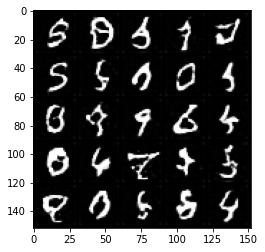

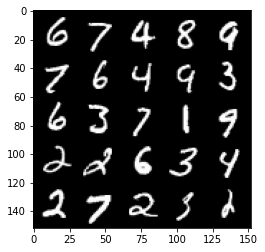

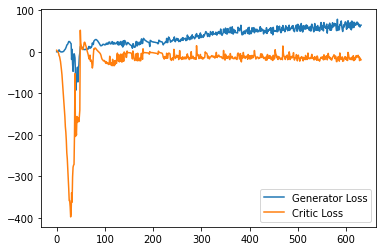

Step 12700: Generator loss: 67.92308242797851, critic loss: -16.153098418712613


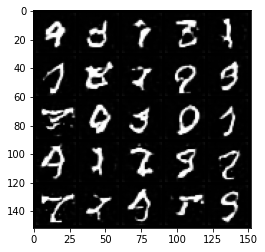

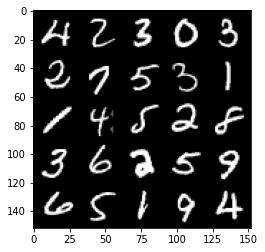

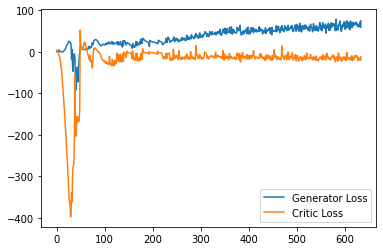

Step 12750: Generator loss: 68.27323211669922, critic loss: -9.466576461076736


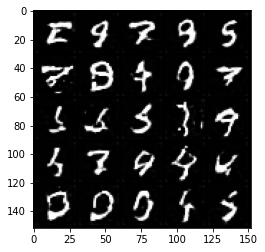

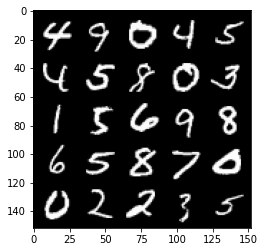

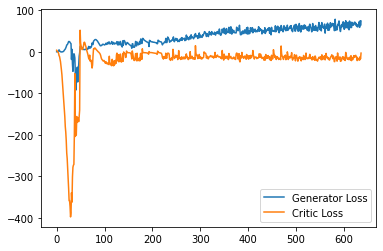

Step 12800: Generator loss: 70.22458572387696, critic loss: -14.412878534555437


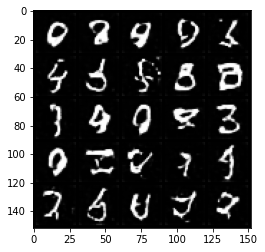

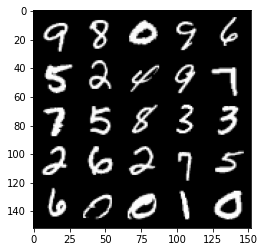

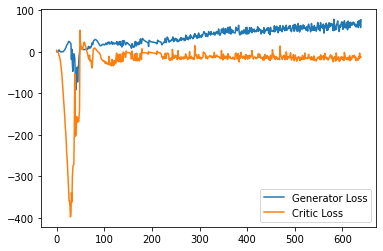

Step 12850: Generator loss: 71.07882354736329, critic loss: -12.992400443553926


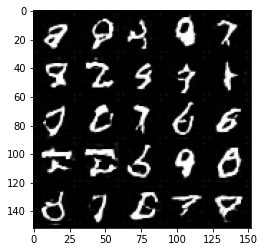

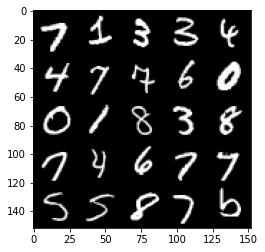

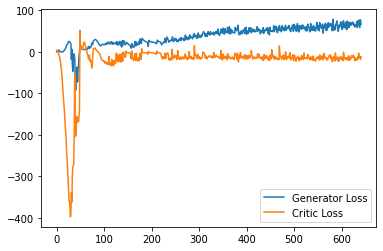

Step 12900: Generator loss: 68.10226295471192, critic loss: -11.208652741909026


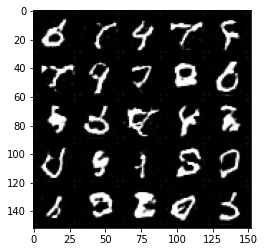

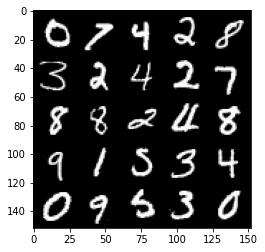

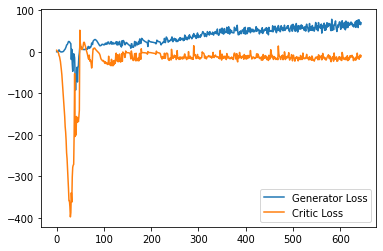

Step 12950: Generator loss: 64.99119148254394, critic loss: -15.542056154727934


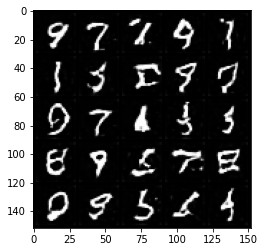

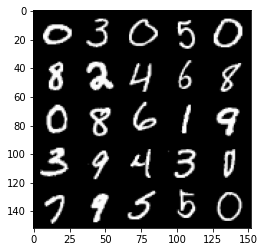

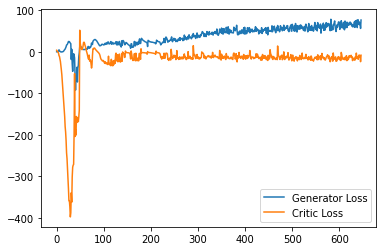

Step 13000: Generator loss: 68.30605346679687, critic loss: -17.791672481060033


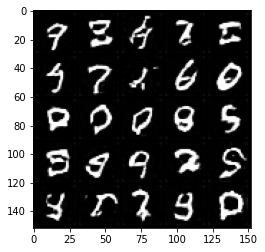

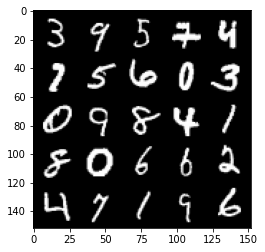

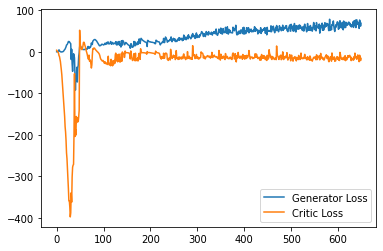

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
